Dataset citation
@online{chao2019/online,
  author       = {Brian Chao},
  title        = {Anime Face Dataset: a collection of high-quality anime faces.},
  date         = {2019-09-16},
  year         = {2019},
  url          = {https://github.com/bchao1/Anime-Face-Dataset}
}

### download images

In [ ]:
!pip install kaggle

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
!mkdir ~/.kaggle
!touch ~/.kaggle/kaggle.json

api_token = {"username":"zayuer","key":"4ef7f664989c96f604f175ddbf7b139c"}

import json

with open('/root/.kaggle/kaggle.json', 'w') as file:
    json.dump(api_token, file)

!chmod 600 ~/.kaggle/kaggle.json

mkdir: cannot create directory ‘/root/.kaggle’: File exists


In [ ]:
from google.colab import files

uploaded = files.upload()
for fn in uploaded.keys():
  print('User uploaded file "{name}" with length {length} bytes'.format(
      name=fn, length=len(uploaded[fn])))



Saving kaggle.json to kaggle.json
User uploaded file "kaggle.json" with length 62 bytes


In [ ]:
import kaggle
def download_data():
    kaggle.api.authenticate()
    kaggle.api.dataset_download_files('splcher/animefacedataset', path='/content/gdrive/MyDrive/cse_676/final_project/images', unzip=True)
download_data()


### Device,mout,libraries, and hyperparameter

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive', force_remount=True)

Mounted at /content/gdrive


In [ ]:
BATCH_SIZE=512
latent_dim=64

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
import numpy as np
from torchvision import datasets, models, transforms
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import matplotlib.image as img
import torch.utils.data as data
import torch.nn.functional as F
from tqdm.notebook import tqdm
from torch.autograd import Variable

In [ ]:
device='cuda' if torch.cuda.is_available() else 'cpu'
device

'cuda'

### Networks and training function

In [ ]:
class Generator(nn.Module):
    def __init__(self,img_shape):
        super(Generator,self).__init__()
        self.layer1 = nn.Sequential(
            nn.Linear(64,256),
            nn.BatchNorm1d(256),
            nn.ReLU())
        self.layer2 = nn.Sequential(
            nn.Linear(256,1024),
            nn.BatchNorm1d(1024),
            nn.ReLU())
        self.layer3 = nn.Sequential(
            nn.Linear(1024,4096),
            nn.BatchNorm1d(4096),
            nn.ReLU())
        self.layer4 = nn.Sequential(
            nn.Linear(4096,int(np.prod(img_shape))),
            nn.Tanh())
        self.img_shape=img_shape


    def forward(self,x):
        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)
        x = self.layer4(x)
        x=x.view(x.size(0),*self.img_shape)
        return x

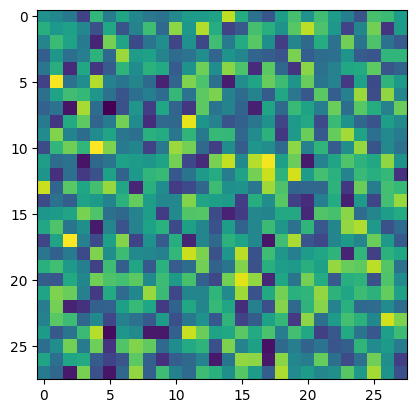

In [ ]:
G=Generator((1,28,28)).to(device)
noise =  torch.randn(5, 64, device=device)
fake_images = G(noise)

plt.imshow(fake_images[0].cpu().detach().permute(1, 2, 0) )

In [ ]:
class Discriminator(nn.Module):
    def __init__(self,img_shape):
        super(Discriminator, self).__init__()

        self.layer1 = nn.Sequential(
            nn.Linear(int(np.prod(img_shape)),4096),
            nn.ReLU())
        self.layer2 = nn.Sequential(
            nn.Linear(4096,1024),
            nn.ReLU())
        self.layer3 = nn.Sequential(
            nn.Linear(1024,256),
            nn.ReLU())
        self.layer4 = nn.Sequential(
            nn.Linear(256,1),
            nn.Sigmoid())

    def forward(self, x):
        x = x.view(x.size(0), -1)
        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)
        x = self.layer4(x)
        return x

In [ ]:
D=Discriminator((1, 28, 28)).to(device)
yes=D(fake_images)
yes

tensor([[0.4828],
        [0.4872],
        [0.4870],
        [0.4855],
        [0.4853]], device='cuda:0', grad_fn=<SigmoidBackward0>)

In [ ]:
Tensor = torch.cuda.FloatTensor if device=='cuda' else torch.FloatTensor

In [ ]:
def train(n_epochs,data_loader,optimizer_G,optimizer_D,G,D,criterion):
  for epoch in range(n_epochs):
    for i, data in enumerate(data_loader,0):

        real_images=data[0].to(device)
        real_label= torch.ones(len(data[1])).to(device).unsqueeze(1)
        fake_label= torch.zeros(len(data[1])).to(device).unsqueeze(1)

        # generate and check
        noise =  torch.randn(len(data[1]), latent_dim, device=device)
        fake_images = G(noise)

        # Discrimiator update
        optimizer_D.zero_grad()

        D_real_images_loss=criterion(D(real_images), real_label)
        D_fake_images_loss = criterion(D(fake_images.detach()), fake_label)
        D_loss=(D_real_images_loss+D_fake_images_loss)/2

        D_loss.backward()
        optimizer_D.step()

        # Generator update
        optimizer_G.zero_grad()
        G_loss=criterion( D(fake_images), real_label)
        G_loss.backward()
        optimizer_G.step()

    print(
        "[Epoch: %d/%d] [Batch: %d/%d] [D loss: %f] [G loss: %f]"
        % (epoch+1, n_epochs, i+1, len(data_loader), D_loss.item(), G_loss.item())
        )
    noise =  torch.randn(64, latent_dim, device=device)
    fake_images = G(noise).detach().cpu()
    print(fake_images.shape)
    fig, axes = plt.subplots(nrows=1,ncols=5, figsize=(8,2))
    plt.suptitle('EPOCH : %d '% (epoch+1))
    for ncol in range(5):
        axes[ncol].axis('off')
        axes[ncol].imshow(fake_images.permute(0,2,3,1)[ncol], cmap='gray')
    plt.show()


### Minst data train

In [ ]:
mnist_transform = transforms.Compose(
    [transforms.ToTensor(),
     transforms.Normalize([0.5], [0.5]),
     ])
mnist_set = datasets.MNIST(root='/content/gdrive/MyDrive/cse_676/final_project/', train=True, download=True, transform=mnist_transform)
mnist_loader = data.DataLoader(dataset=mnist_set, batch_size=BATCH_SIZE, shuffle=True)
img_shape=(1,28,28)

torch.Size([1, 28, 28])


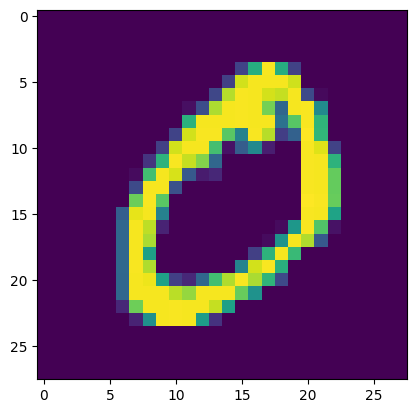

In [ ]:
tensor_image = mnist_set[1][0]
print(tensor_image.shape)
plt.imshow(tensor_image.permute(1, 2, 0)  )

In [ ]:
mnist_criterion = torch.nn.BCELoss().to(device)
mnist_G=Generator(img_shape).to(device)
mnist_D=Discriminator(img_shape).to(device)
mnist_optimizer_G = optim.Adam(mnist_G.parameters())
mnist_optimizer_D = optim.Adam(mnist_D.parameters())

[Epoch: 1/100] [Batch: 469/469] [D loss: 0.038584] [G loss: 14.606818]
torch.Size([64, 1, 28, 28])


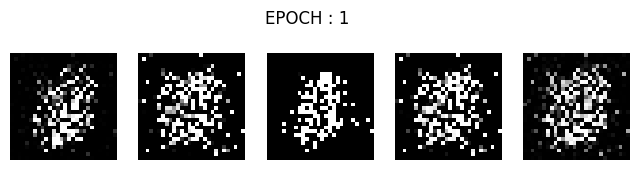

[Epoch: 2/100] [Batch: 469/469] [D loss: 0.073132] [G loss: 9.301723]
torch.Size([64, 1, 28, 28])


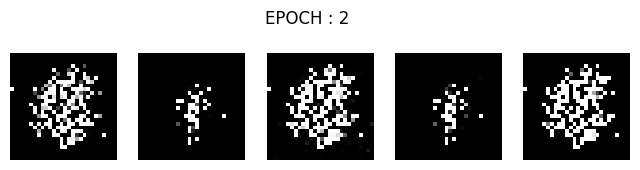

[Epoch: 3/100] [Batch: 469/469] [D loss: 1.920337] [G loss: 11.506536]
torch.Size([64, 1, 28, 28])


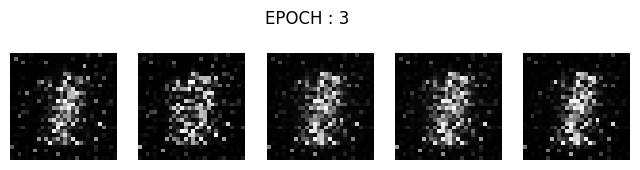

[Epoch: 4/100] [Batch: 469/469] [D loss: 0.037548] [G loss: 9.500610]
torch.Size([64, 1, 28, 28])


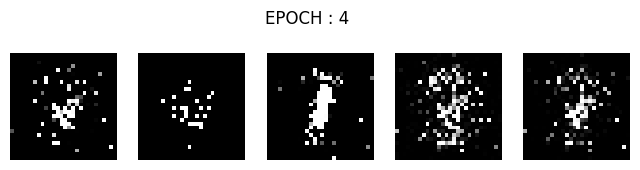

[Epoch: 5/100] [Batch: 469/469] [D loss: 0.428963] [G loss: 3.193506]
torch.Size([64, 1, 28, 28])


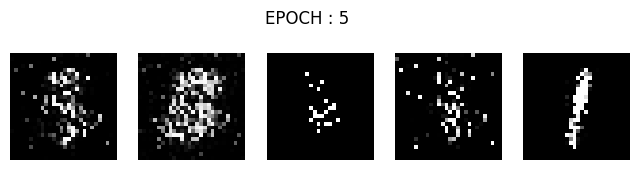

[Epoch: 6/100] [Batch: 469/469] [D loss: 0.154661] [G loss: 6.296432]
torch.Size([64, 1, 28, 28])


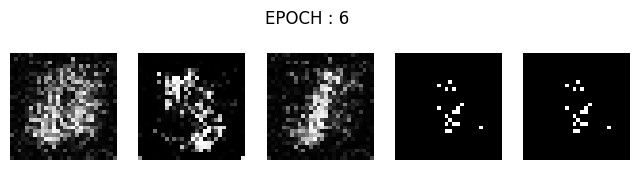

[Epoch: 7/100] [Batch: 469/469] [D loss: 0.098895] [G loss: 5.142319]
torch.Size([64, 1, 28, 28])


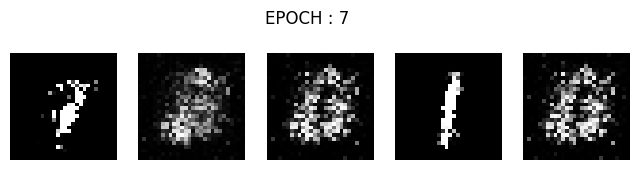

[Epoch: 8/100] [Batch: 469/469] [D loss: 0.032692] [G loss: 15.132193]
torch.Size([64, 1, 28, 28])


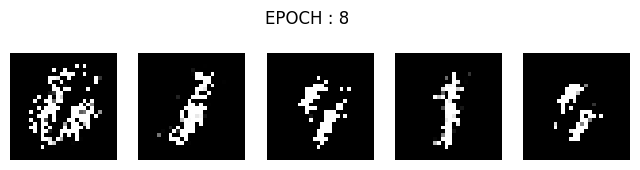

[Epoch: 9/100] [Batch: 469/469] [D loss: 0.173582] [G loss: 7.476321]
torch.Size([64, 1, 28, 28])


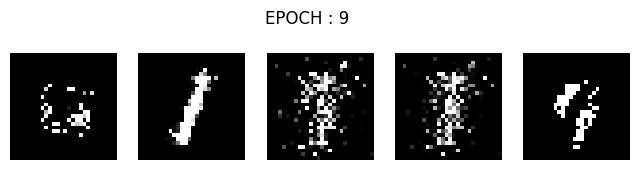

[Epoch: 10/100] [Batch: 469/469] [D loss: 0.260988] [G loss: 7.145634]
torch.Size([64, 1, 28, 28])


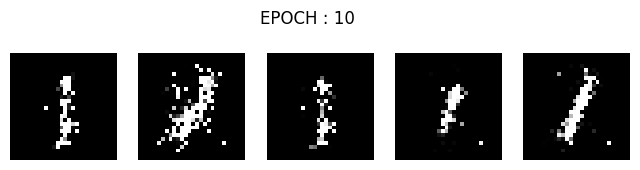

[Epoch: 11/100] [Batch: 469/469] [D loss: 0.415705] [G loss: 3.237997]
torch.Size([64, 1, 28, 28])


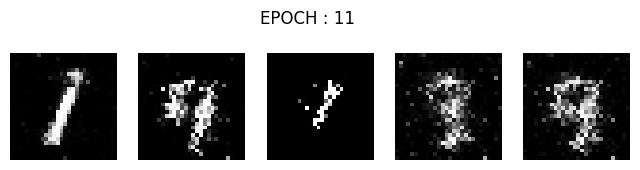

[Epoch: 12/100] [Batch: 469/469] [D loss: 0.433661] [G loss: 6.205817]
torch.Size([64, 1, 28, 28])


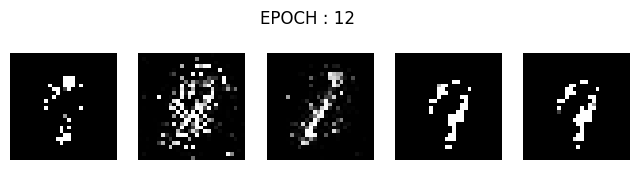

[Epoch: 13/100] [Batch: 469/469] [D loss: 0.449863] [G loss: 3.071779]
torch.Size([64, 1, 28, 28])


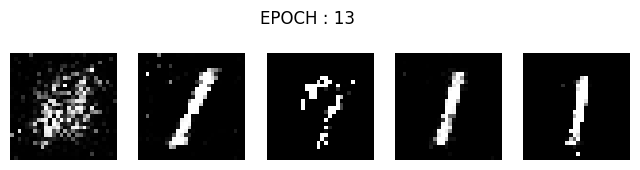

[Epoch: 14/100] [Batch: 469/469] [D loss: 0.282973] [G loss: 2.752606]
torch.Size([64, 1, 28, 28])


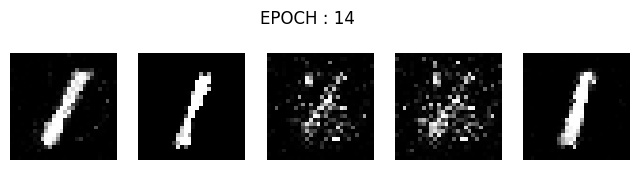

[Epoch: 15/100] [Batch: 469/469] [D loss: 0.173518] [G loss: 3.123156]
torch.Size([64, 1, 28, 28])


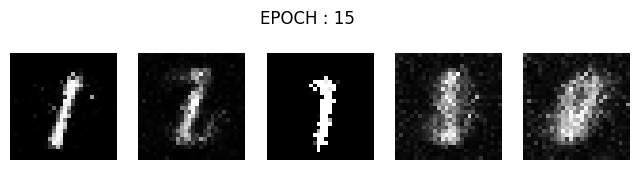

[Epoch: 16/100] [Batch: 469/469] [D loss: 0.421259] [G loss: 1.847680]
torch.Size([64, 1, 28, 28])


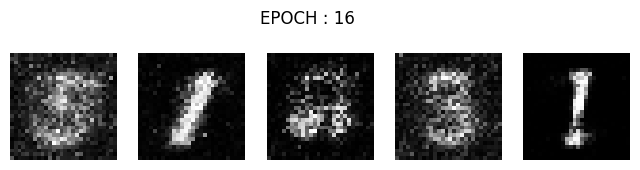

[Epoch: 17/100] [Batch: 469/469] [D loss: 0.276229] [G loss: 2.303557]
torch.Size([64, 1, 28, 28])


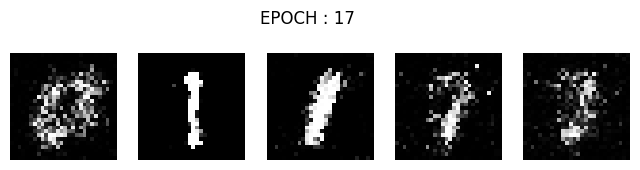

[Epoch: 18/100] [Batch: 469/469] [D loss: 0.446355] [G loss: 2.581503]
torch.Size([64, 1, 28, 28])


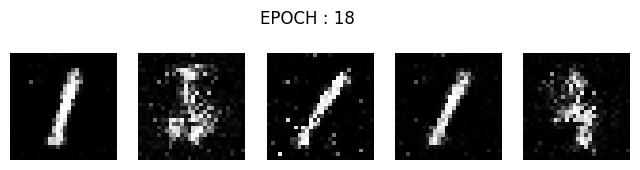

[Epoch: 19/100] [Batch: 469/469] [D loss: 0.383581] [G loss: 3.321895]
torch.Size([64, 1, 28, 28])


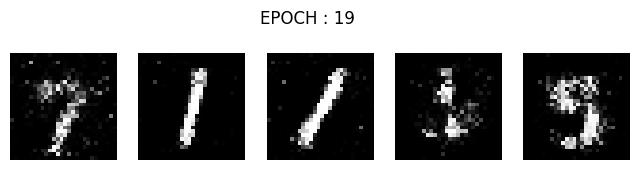

[Epoch: 20/100] [Batch: 469/469] [D loss: 0.340310] [G loss: 2.319763]
torch.Size([64, 1, 28, 28])


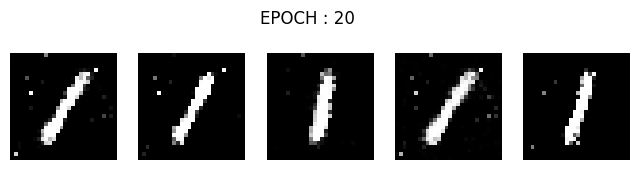

[Epoch: 21/100] [Batch: 469/469] [D loss: 0.440925] [G loss: 0.879083]
torch.Size([64, 1, 28, 28])


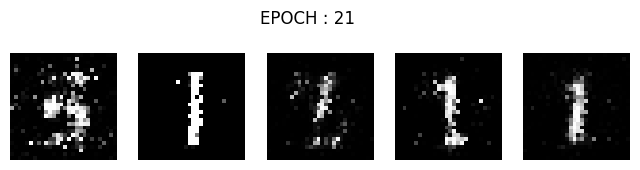

[Epoch: 22/100] [Batch: 469/469] [D loss: 0.378097] [G loss: 1.923138]
torch.Size([64, 1, 28, 28])


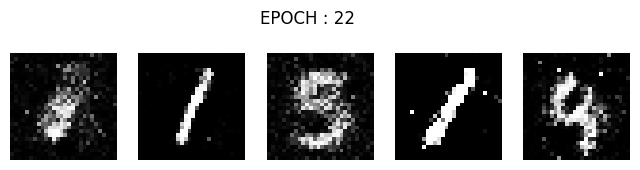

[Epoch: 23/100] [Batch: 469/469] [D loss: 0.500885] [G loss: 1.354384]
torch.Size([64, 1, 28, 28])


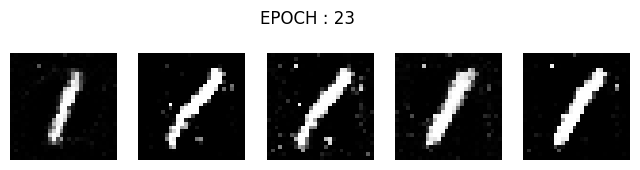

[Epoch: 24/100] [Batch: 469/469] [D loss: 0.559353] [G loss: 1.336676]
torch.Size([64, 1, 28, 28])


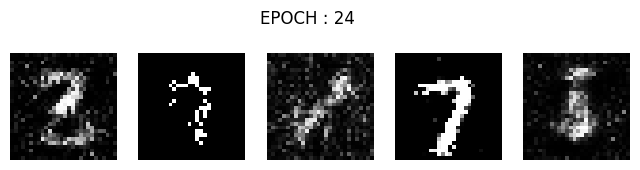

[Epoch: 25/100] [Batch: 469/469] [D loss: 0.477503] [G loss: 2.350534]
torch.Size([64, 1, 28, 28])


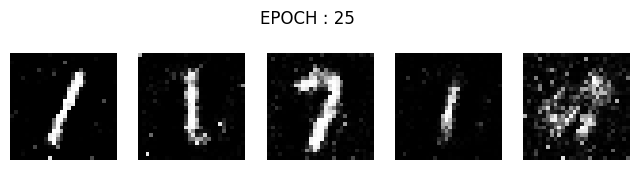

[Epoch: 26/100] [Batch: 469/469] [D loss: 0.326312] [G loss: 2.613711]
torch.Size([64, 1, 28, 28])


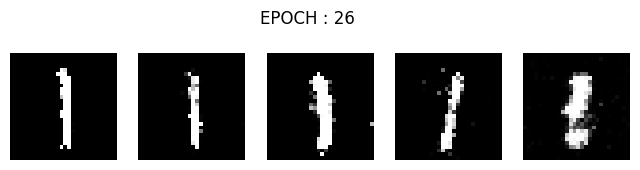

[Epoch: 27/100] [Batch: 469/469] [D loss: 0.384908] [G loss: 2.949673]
torch.Size([64, 1, 28, 28])


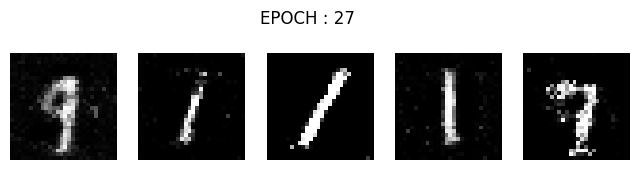

[Epoch: 28/100] [Batch: 469/469] [D loss: 1.057033] [G loss: 2.813031]
torch.Size([64, 1, 28, 28])


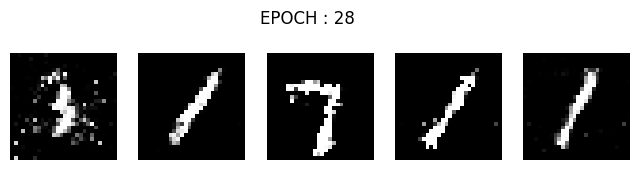

[Epoch: 29/100] [Batch: 469/469] [D loss: 0.451321] [G loss: 1.834067]
torch.Size([64, 1, 28, 28])


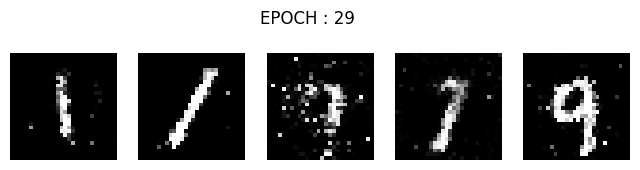

[Epoch: 30/100] [Batch: 469/469] [D loss: 0.381866] [G loss: 1.403759]
torch.Size([64, 1, 28, 28])


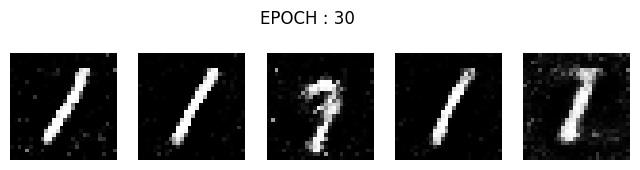

[Epoch: 31/100] [Batch: 469/469] [D loss: 0.457334] [G loss: 2.527565]
torch.Size([64, 1, 28, 28])


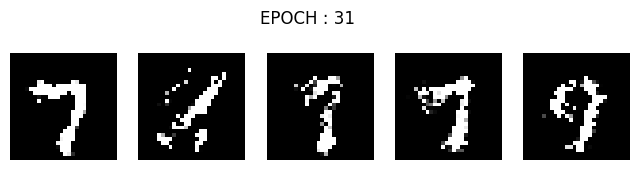

[Epoch: 32/100] [Batch: 469/469] [D loss: 0.429975] [G loss: 2.056585]
torch.Size([64, 1, 28, 28])


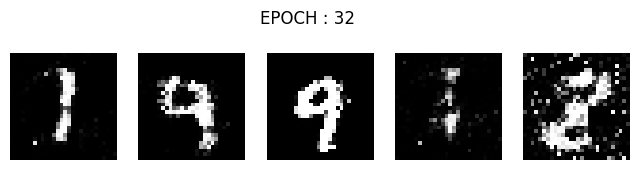

[Epoch: 33/100] [Batch: 469/469] [D loss: 0.398241] [G loss: 1.691162]
torch.Size([64, 1, 28, 28])


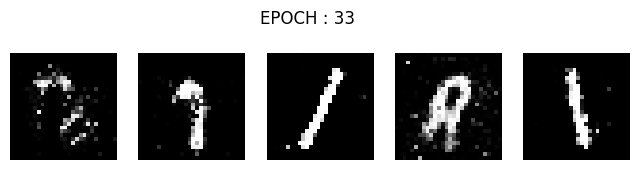

[Epoch: 34/100] [Batch: 469/469] [D loss: 0.416816] [G loss: 1.599934]
torch.Size([64, 1, 28, 28])


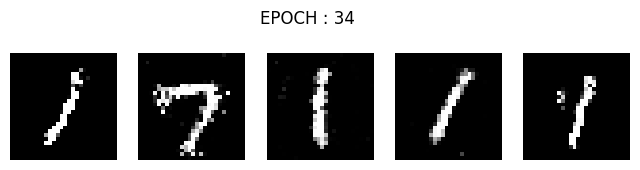

[Epoch: 35/100] [Batch: 469/469] [D loss: 0.521150] [G loss: 2.322327]
torch.Size([64, 1, 28, 28])


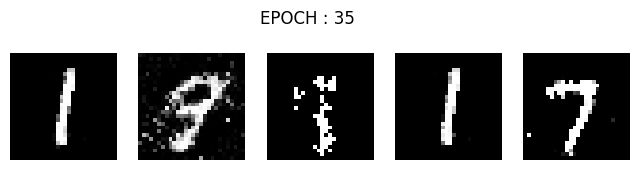

[Epoch: 36/100] [Batch: 469/469] [D loss: 0.499739] [G loss: 1.284676]
torch.Size([64, 1, 28, 28])


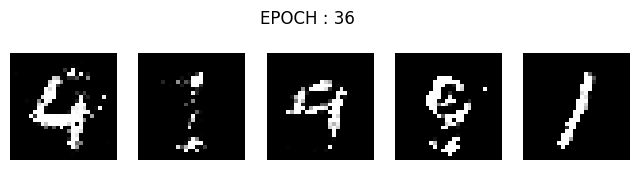

[Epoch: 37/100] [Batch: 469/469] [D loss: 0.476759] [G loss: 1.839922]
torch.Size([64, 1, 28, 28])


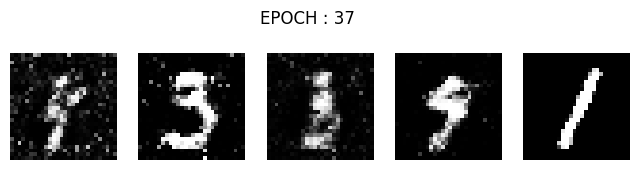

[Epoch: 38/100] [Batch: 469/469] [D loss: 0.559179] [G loss: 1.236467]
torch.Size([64, 1, 28, 28])


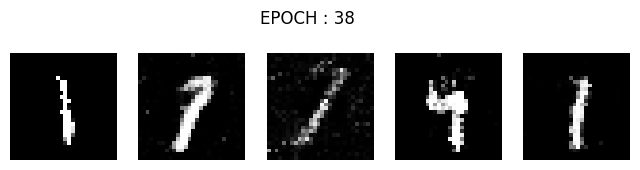

[Epoch: 39/100] [Batch: 469/469] [D loss: 0.496578] [G loss: 1.256327]
torch.Size([64, 1, 28, 28])


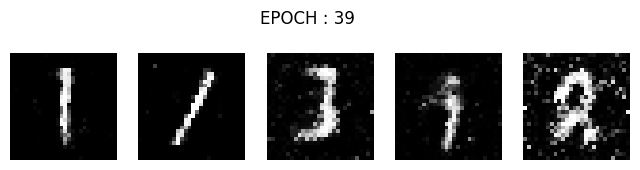

[Epoch: 40/100] [Batch: 469/469] [D loss: 0.443406] [G loss: 1.687373]
torch.Size([64, 1, 28, 28])


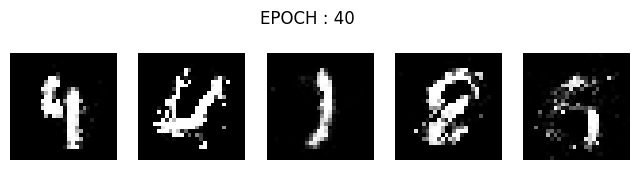

[Epoch: 41/100] [Batch: 469/469] [D loss: 0.619924] [G loss: 1.431696]
torch.Size([64, 1, 28, 28])


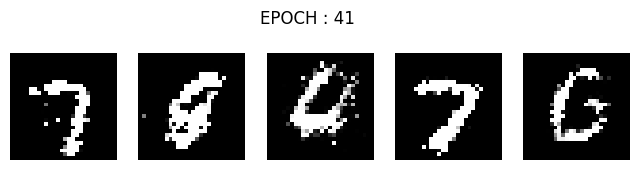

[Epoch: 42/100] [Batch: 469/469] [D loss: 0.517118] [G loss: 1.313926]
torch.Size([64, 1, 28, 28])


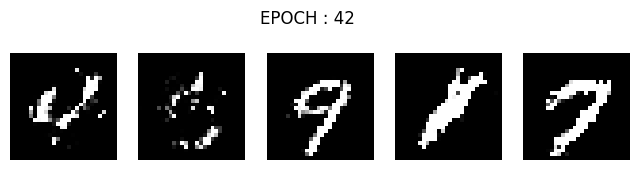

[Epoch: 43/100] [Batch: 469/469] [D loss: 0.506785] [G loss: 1.400934]
torch.Size([64, 1, 28, 28])


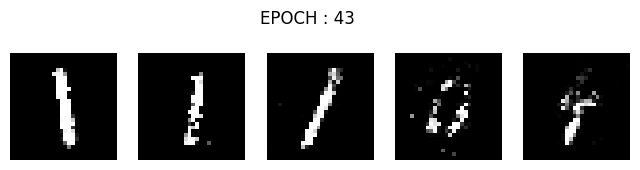

[Epoch: 44/100] [Batch: 469/469] [D loss: 0.458365] [G loss: 1.630006]
torch.Size([64, 1, 28, 28])


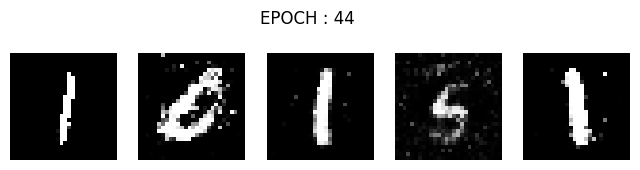

[Epoch: 45/100] [Batch: 469/469] [D loss: 0.515388] [G loss: 1.927402]
torch.Size([64, 1, 28, 28])


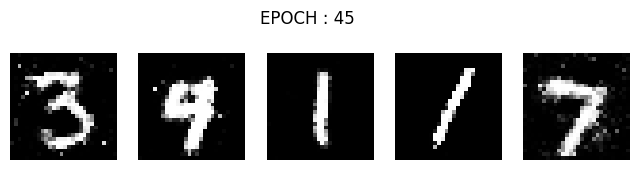

[Epoch: 46/100] [Batch: 469/469] [D loss: 0.574386] [G loss: 1.515809]
torch.Size([64, 1, 28, 28])


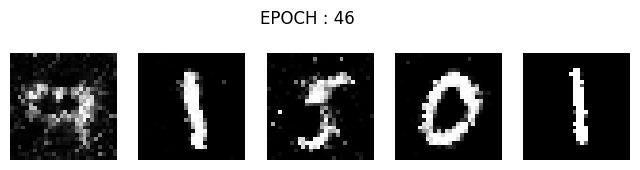

[Epoch: 47/100] [Batch: 469/469] [D loss: 0.536433] [G loss: 1.556859]
torch.Size([64, 1, 28, 28])


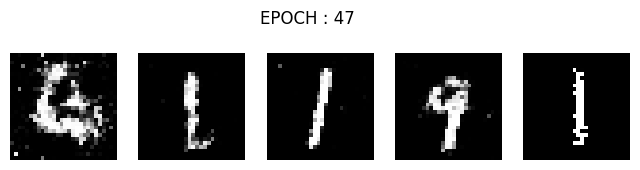

[Epoch: 48/100] [Batch: 469/469] [D loss: 0.602087] [G loss: 1.408813]
torch.Size([64, 1, 28, 28])


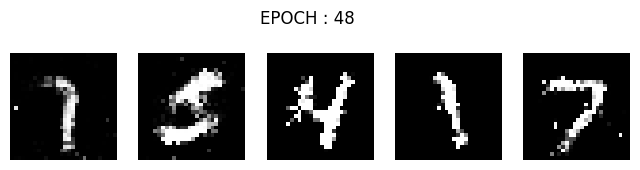

[Epoch: 49/100] [Batch: 469/469] [D loss: 0.565247] [G loss: 1.476997]
torch.Size([64, 1, 28, 28])


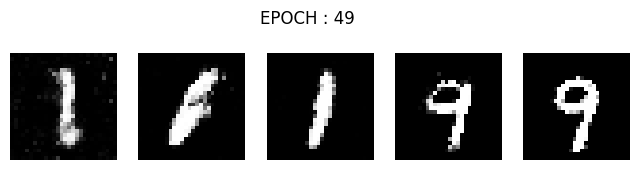

[Epoch: 50/100] [Batch: 469/469] [D loss: 0.580176] [G loss: 1.361183]
torch.Size([64, 1, 28, 28])


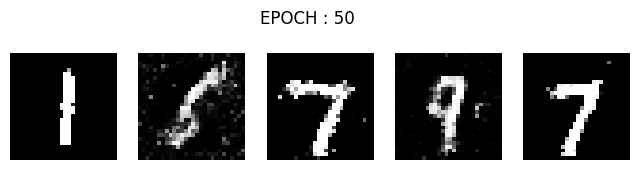

[Epoch: 51/100] [Batch: 469/469] [D loss: 0.628359] [G loss: 1.086533]
torch.Size([64, 1, 28, 28])


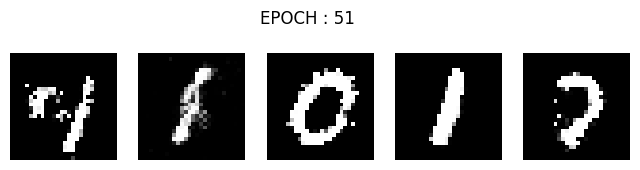

[Epoch: 52/100] [Batch: 469/469] [D loss: 0.562076] [G loss: 1.569428]
torch.Size([64, 1, 28, 28])


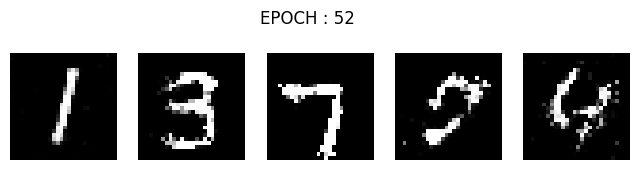

[Epoch: 53/100] [Batch: 469/469] [D loss: 0.646759] [G loss: 1.327101]
torch.Size([64, 1, 28, 28])


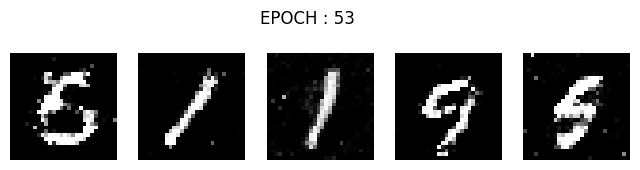

[Epoch: 54/100] [Batch: 469/469] [D loss: 0.595205] [G loss: 1.499880]
torch.Size([64, 1, 28, 28])


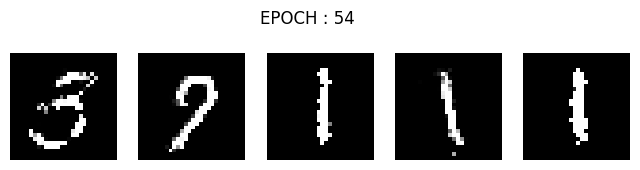

[Epoch: 55/100] [Batch: 469/469] [D loss: 0.535236] [G loss: 1.206865]
torch.Size([64, 1, 28, 28])


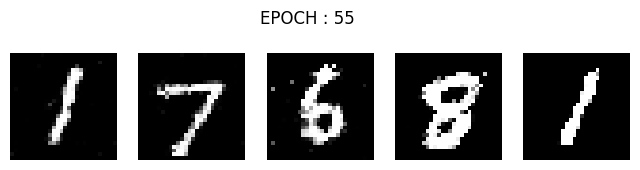

[Epoch: 56/100] [Batch: 469/469] [D loss: 0.503492] [G loss: 1.189635]
torch.Size([64, 1, 28, 28])


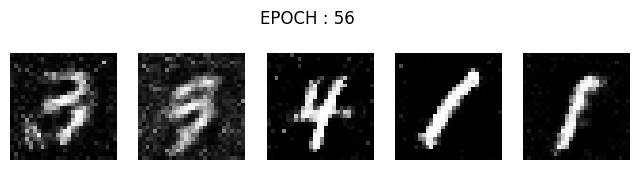

[Epoch: 57/100] [Batch: 469/469] [D loss: 0.587599] [G loss: 1.655371]
torch.Size([64, 1, 28, 28])


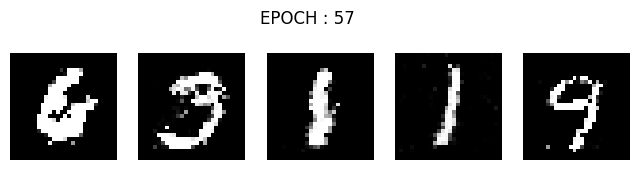

[Epoch: 58/100] [Batch: 469/469] [D loss: 0.614853] [G loss: 1.106879]
torch.Size([64, 1, 28, 28])


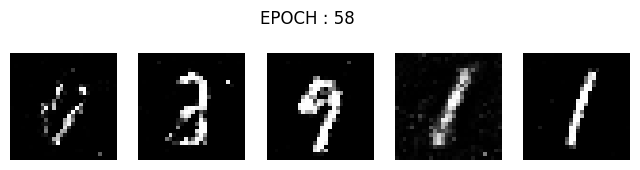

[Epoch: 59/100] [Batch: 469/469] [D loss: 0.544542] [G loss: 1.561288]
torch.Size([64, 1, 28, 28])


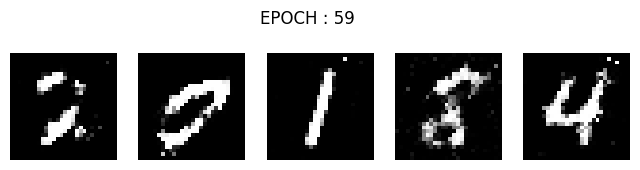

[Epoch: 60/100] [Batch: 469/469] [D loss: 0.617630] [G loss: 1.133283]
torch.Size([64, 1, 28, 28])


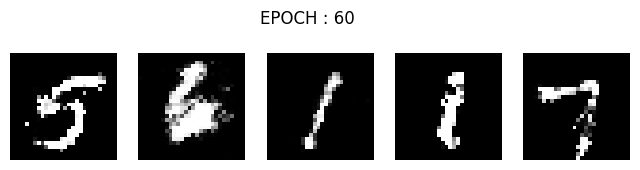

[Epoch: 61/100] [Batch: 469/469] [D loss: 0.575642] [G loss: 1.149120]
torch.Size([64, 1, 28, 28])


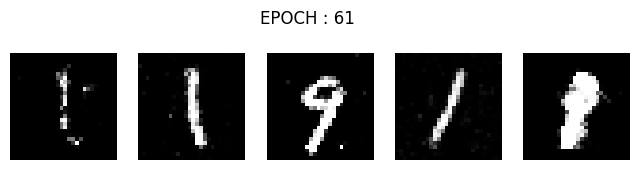

[Epoch: 62/100] [Batch: 469/469] [D loss: 0.748748] [G loss: 1.154221]
torch.Size([64, 1, 28, 28])


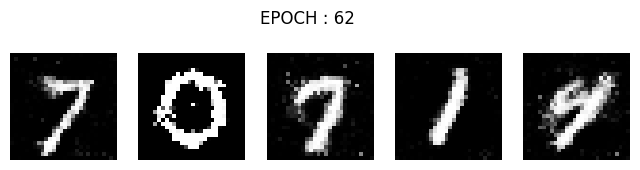

[Epoch: 63/100] [Batch: 469/469] [D loss: 0.678096] [G loss: 1.022595]
torch.Size([64, 1, 28, 28])


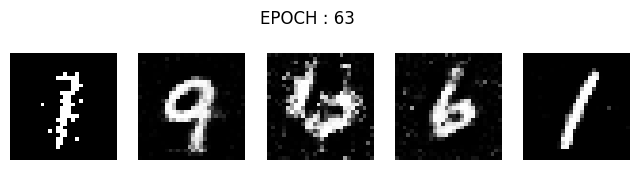

[Epoch: 64/100] [Batch: 469/469] [D loss: 0.598293] [G loss: 1.122644]
torch.Size([64, 1, 28, 28])


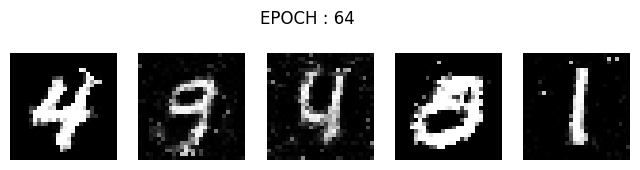

[Epoch: 65/100] [Batch: 469/469] [D loss: 0.613650] [G loss: 1.237062]
torch.Size([64, 1, 28, 28])


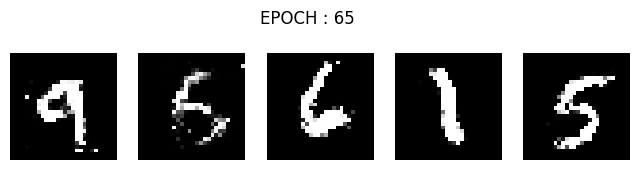

[Epoch: 66/100] [Batch: 469/469] [D loss: 0.591303] [G loss: 0.949685]
torch.Size([64, 1, 28, 28])


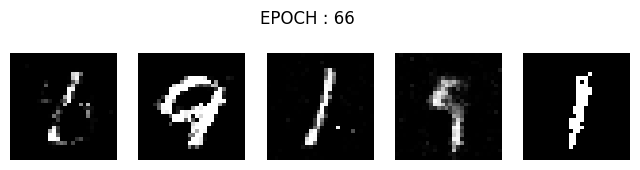

[Epoch: 67/100] [Batch: 469/469] [D loss: 0.597757] [G loss: 0.981288]
torch.Size([64, 1, 28, 28])


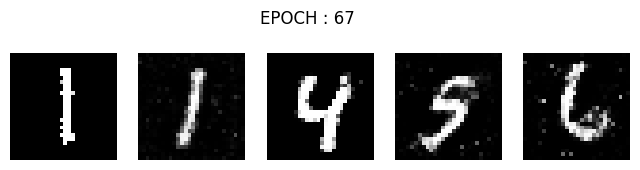

[Epoch: 68/100] [Batch: 469/469] [D loss: 0.633775] [G loss: 1.210149]
torch.Size([64, 1, 28, 28])


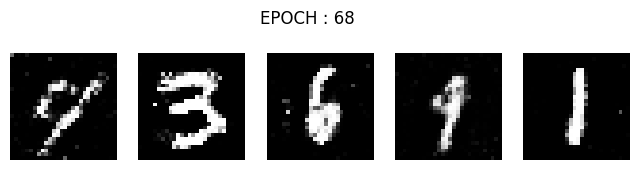

[Epoch: 69/100] [Batch: 469/469] [D loss: 0.505851] [G loss: 1.235698]
torch.Size([64, 1, 28, 28])


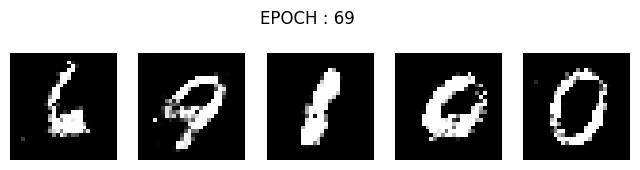

[Epoch: 70/100] [Batch: 469/469] [D loss: 0.628986] [G loss: 1.119303]
torch.Size([64, 1, 28, 28])


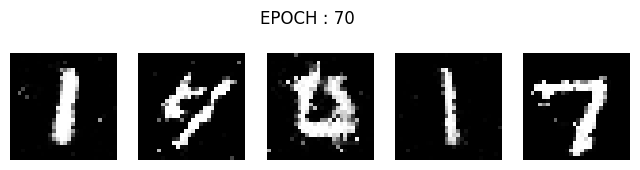

[Epoch: 71/100] [Batch: 469/469] [D loss: 0.658923] [G loss: 1.105060]
torch.Size([64, 1, 28, 28])


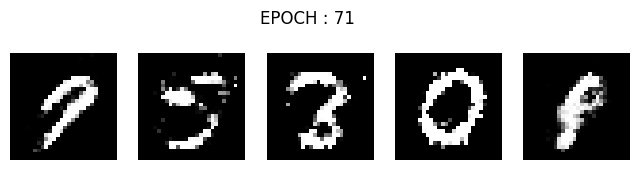

[Epoch: 72/100] [Batch: 469/469] [D loss: 0.658658] [G loss: 0.923254]
torch.Size([64, 1, 28, 28])


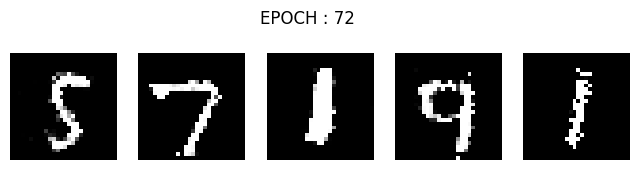

[Epoch: 73/100] [Batch: 469/469] [D loss: 0.557143] [G loss: 1.306845]
torch.Size([64, 1, 28, 28])


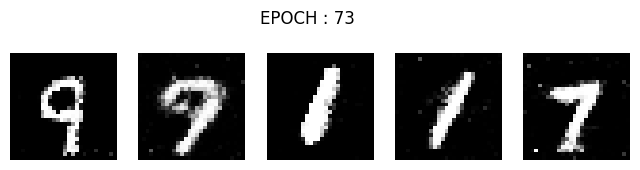

[Epoch: 74/100] [Batch: 469/469] [D loss: 0.634123] [G loss: 1.033558]
torch.Size([64, 1, 28, 28])


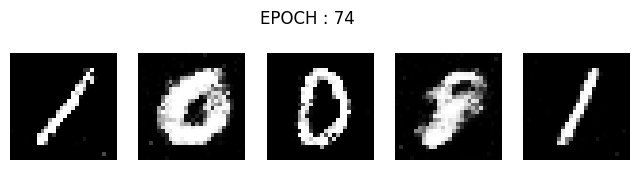

[Epoch: 75/100] [Batch: 469/469] [D loss: 0.739315] [G loss: 1.244627]
torch.Size([64, 1, 28, 28])


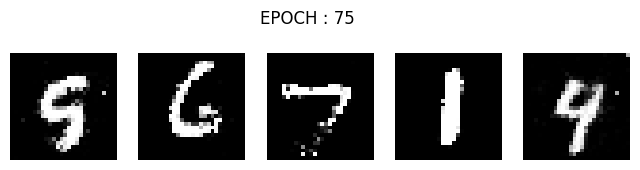

[Epoch: 76/100] [Batch: 469/469] [D loss: 0.577294] [G loss: 1.141334]
torch.Size([64, 1, 28, 28])


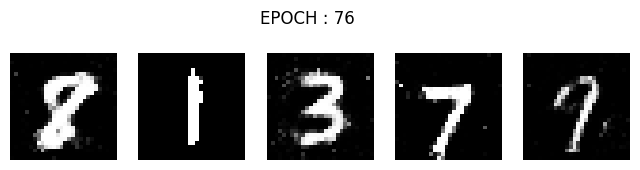

[Epoch: 77/100] [Batch: 469/469] [D loss: 0.510791] [G loss: 1.593857]
torch.Size([64, 1, 28, 28])


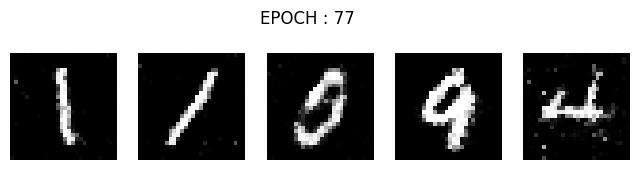

[Epoch: 78/100] [Batch: 469/469] [D loss: 0.706217] [G loss: 0.947950]
torch.Size([64, 1, 28, 28])


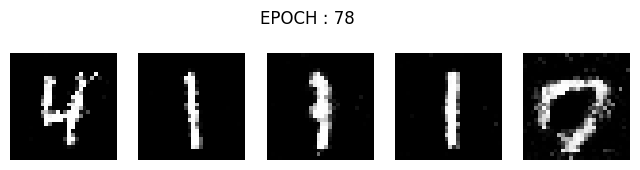

[Epoch: 79/100] [Batch: 469/469] [D loss: 0.558906] [G loss: 1.159297]
torch.Size([64, 1, 28, 28])


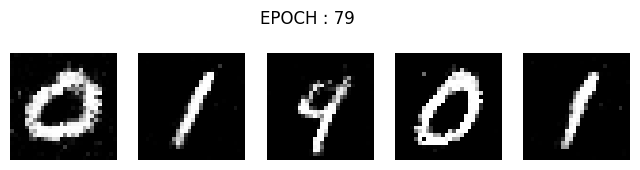

[Epoch: 80/100] [Batch: 469/469] [D loss: 0.645960] [G loss: 1.090209]
torch.Size([64, 1, 28, 28])


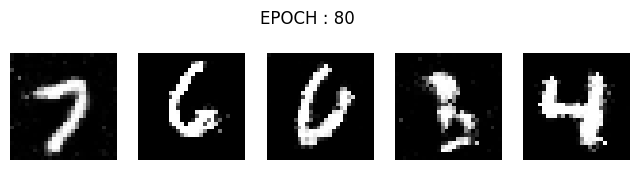

[Epoch: 81/100] [Batch: 469/469] [D loss: 0.667598] [G loss: 1.173291]
torch.Size([64, 1, 28, 28])


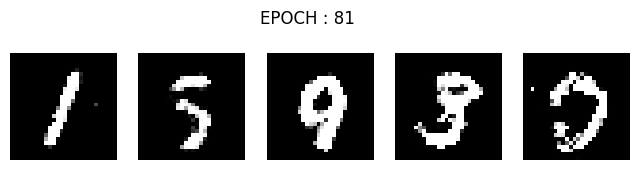

[Epoch: 82/100] [Batch: 469/469] [D loss: 0.643883] [G loss: 1.135494]
torch.Size([64, 1, 28, 28])


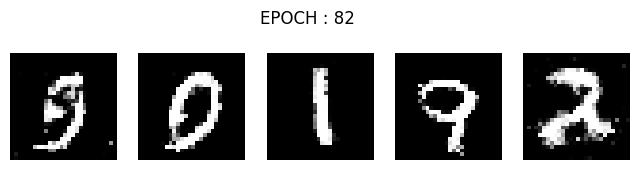

[Epoch: 83/100] [Batch: 469/469] [D loss: 0.655556] [G loss: 1.252690]
torch.Size([64, 1, 28, 28])


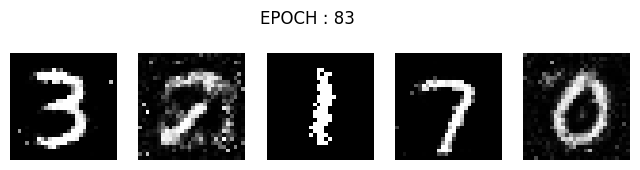

[Epoch: 84/100] [Batch: 469/469] [D loss: 0.712856] [G loss: 1.126941]
torch.Size([64, 1, 28, 28])


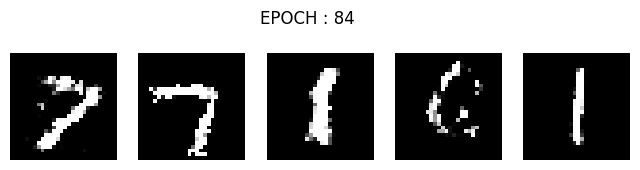

[Epoch: 85/100] [Batch: 469/469] [D loss: 0.572822] [G loss: 1.107793]
torch.Size([64, 1, 28, 28])


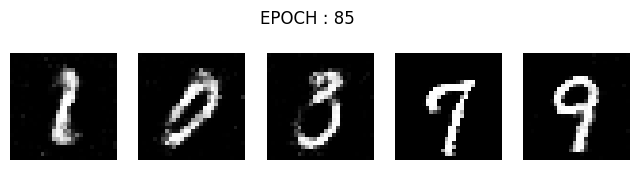

[Epoch: 86/100] [Batch: 469/469] [D loss: 0.733473] [G loss: 0.961677]
torch.Size([64, 1, 28, 28])


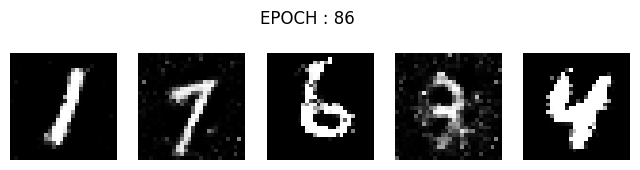

[Epoch: 87/100] [Batch: 469/469] [D loss: 0.647323] [G loss: 0.933454]
torch.Size([64, 1, 28, 28])


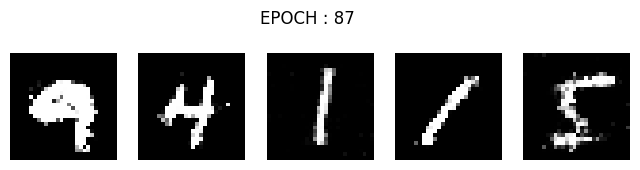

[Epoch: 88/100] [Batch: 469/469] [D loss: 0.749664] [G loss: 1.086000]
torch.Size([64, 1, 28, 28])


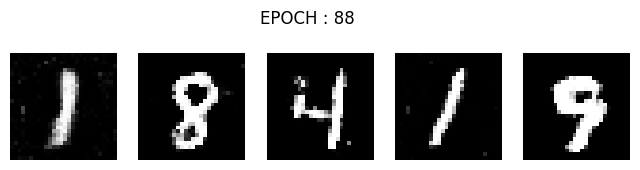

[Epoch: 89/100] [Batch: 469/469] [D loss: 0.754932] [G loss: 0.862223]
torch.Size([64, 1, 28, 28])


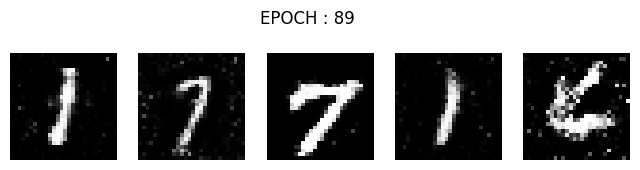

[Epoch: 90/100] [Batch: 469/469] [D loss: 0.657653] [G loss: 0.895034]
torch.Size([64, 1, 28, 28])


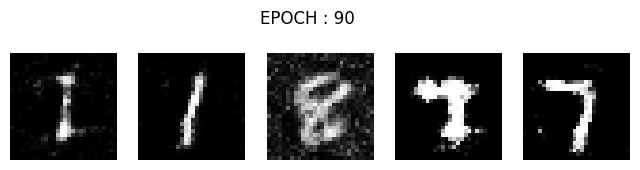

[Epoch: 91/100] [Batch: 469/469] [D loss: 0.644312] [G loss: 0.983759]
torch.Size([64, 1, 28, 28])


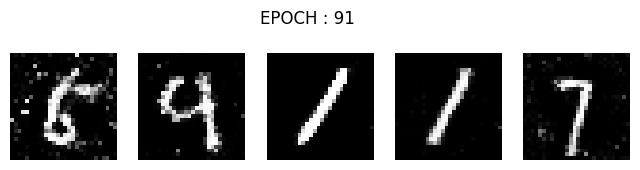

[Epoch: 92/100] [Batch: 469/469] [D loss: 0.692131] [G loss: 1.297298]
torch.Size([64, 1, 28, 28])


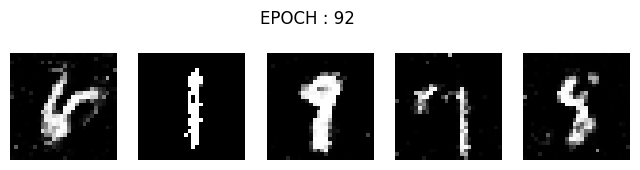

[Epoch: 93/100] [Batch: 469/469] [D loss: 0.695904] [G loss: 1.066840]
torch.Size([64, 1, 28, 28])


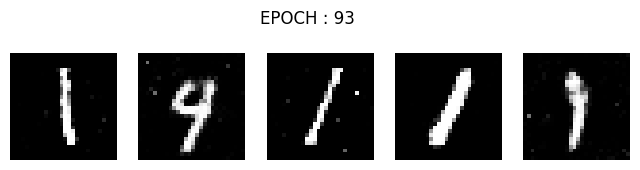

[Epoch: 94/100] [Batch: 469/469] [D loss: 0.766974] [G loss: 0.756553]
torch.Size([64, 1, 28, 28])


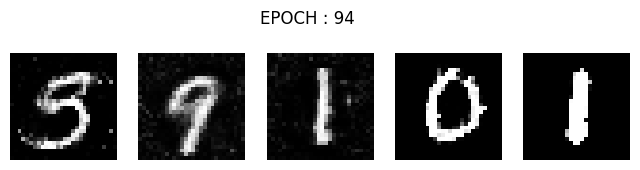

[Epoch: 95/100] [Batch: 469/469] [D loss: 0.769792] [G loss: 1.317031]
torch.Size([64, 1, 28, 28])


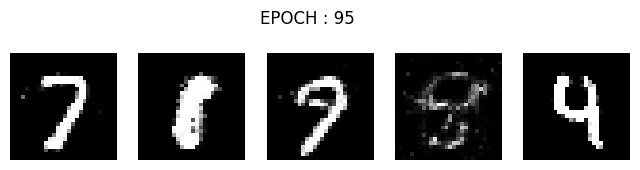

[Epoch: 96/100] [Batch: 469/469] [D loss: 0.710410] [G loss: 1.114864]
torch.Size([64, 1, 28, 28])


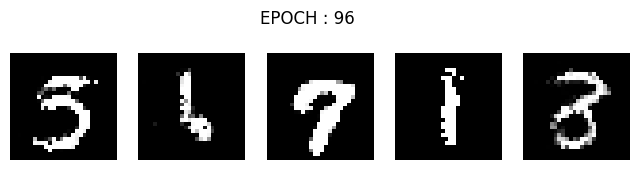

[Epoch: 97/100] [Batch: 469/469] [D loss: 0.720783] [G loss: 0.922409]
torch.Size([64, 1, 28, 28])


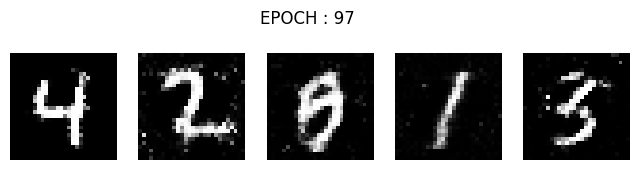

[Epoch: 98/100] [Batch: 469/469] [D loss: 0.535061] [G loss: 1.753211]
torch.Size([64, 1, 28, 28])


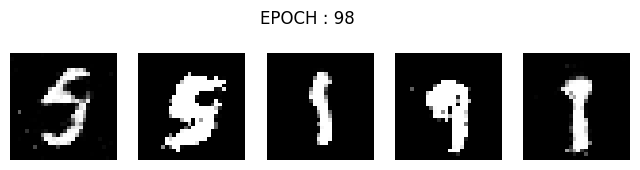

[Epoch: 99/100] [Batch: 469/469] [D loss: 0.649200] [G loss: 0.986356]
torch.Size([64, 1, 28, 28])


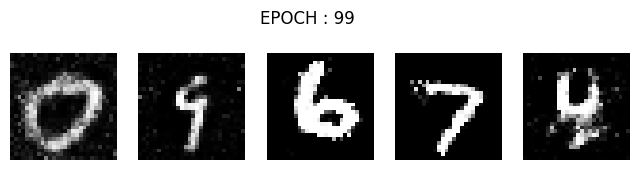

[Epoch: 100/100] [Batch: 469/469] [D loss: 0.644231] [G loss: 1.193146]
torch.Size([64, 1, 28, 28])


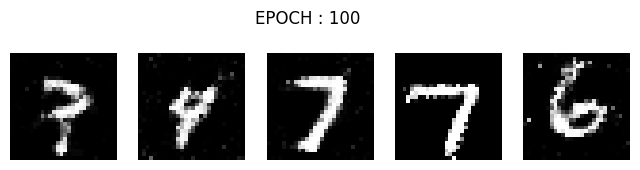

In [ ]:
train(100,mnist_loader,mnist_optimizer_G,mnist_optimizer_D,mnist_G,mnist_D,mnist_criterion)

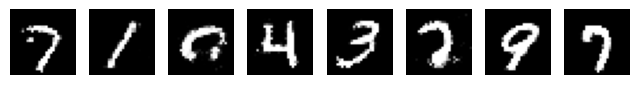

In [ ]:
noise =  torch.randn(64, latent_dim, device=device)
fake_images = mnist_G(noise).detach().cpu()
fig, axes = plt.subplots(nrows=1,ncols=8, figsize=(8,2))
for ncol in range(8):
    axes[ncol].axis('off')
    axes[ncol].imshow(fake_images.permute(0,2,3,1)[ncol], cmap='gray')
plt.show()

In [ ]:
pathG="/content/gdrive/MyDrive/cse_676/Assignment_1/minst_G"
pathD="/content/gdrive/MyDrive/cse_676/Assignment_1/minst_D"
torch.save(mnist_G, pathG)
torch.save(mnist_D, pathD)

### Anime face data

In [ ]:
data_transform = transforms.Compose(
    [transforms.ToTensor(),
     transforms.CenterCrop(latent_dim),
     transforms.Resize(64, interpolation=2),
     transforms.Normalize([0.5, 0.5, 0.5], [0.5, 0.5, 0.5]),
     ])#Image augmentation
data_dir = '/content/gdrive/MyDrive/cse_676/final_project/images'

dataset = datasets.ImageFolder(data_dir,data_transform)
dataset

Dataset ImageFolder
    Number of datapoints: 63565
    Root location: /content/gdrive/MyDrive/cse_676/final_project/images
    StandardTransform
Transform: Compose(
               ToTensor()
               CenterCrop(size=(64, 64))
               Resize(size=64, interpolation=bilinear, max_size=None, antialias=warn)
               Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
           )

/usr/local/lib/python3.10/dist-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(


torch.Size([3, 64, 64])


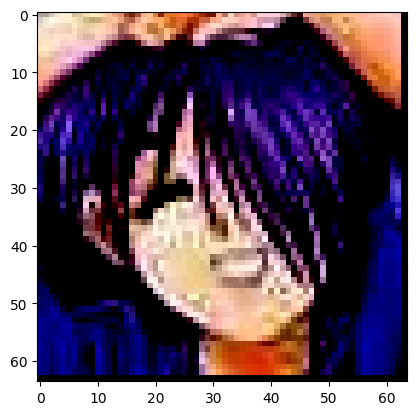

In [ ]:
tensor_image = dataset[0][0]
print(tensor_image.shape)
plt.imshow(tensor_image.permute(1, 2, 0)  )

In [ ]:
size=len(dataset)
np.random.seed(111)
indices = list(range(size))
np.random.shuffle(indices)

training_dataset = data.Subset(dataset, indices[0:int(size*0.70)])
validation_dataset= data.Subset(dataset, indices[int(size*0.70):int(size*0.85)])
testing_dataset = data.Subset(dataset, indices[int(size*0.85):size])

In [ ]:
print(len(training_dataset))
print(len(validation_dataset))
print(len(testing_dataset))

44495
9535
9535


In [ ]:
training_loader = data.DataLoader(dataset=training_dataset, batch_size=BATCH_SIZE, shuffle=True)
validation_loader = data.DataLoader(dataset=validation_dataset, batch_size=2*BATCH_SIZE, shuffle=True)
testing_loader = data.DataLoader(dataset=testing_dataset, batch_size=2*BATCH_SIZE, shuffle=True)

In [ ]:
img_shape=(3,64,64)
criterion = torch.nn.BCELoss().to(device)
G=Generator(img_shape).to(device)
D=Discriminator(img_shape).to(device)
optimizer_G = optim.Adam(G.parameters())
optimizer_D = optim.Adam(D.parameters())

[Epoch: 1/200] [Batch: 348/348] [D loss: 0.000493] [G loss: 36.489841]
torch.Size([64, 3, 64, 64])


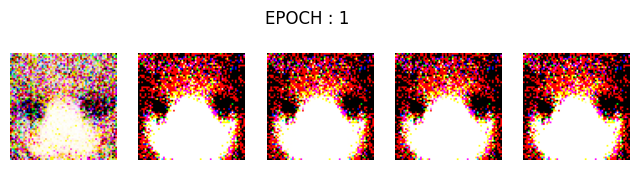

[Epoch: 2/200] [Batch: 348/348] [D loss: 0.140350] [G loss: 19.173010]
torch.Size([64, 3, 64, 64])


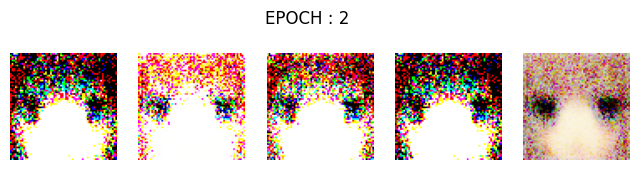

[Epoch: 3/200] [Batch: 348/348] [D loss: 0.012562] [G loss: 30.320728]
torch.Size([64, 3, 64, 64])


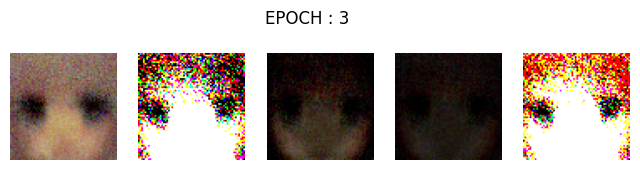

[Epoch: 4/200] [Batch: 348/348] [D loss: 0.096270] [G loss: 23.836796]
torch.Size([64, 3, 64, 64])


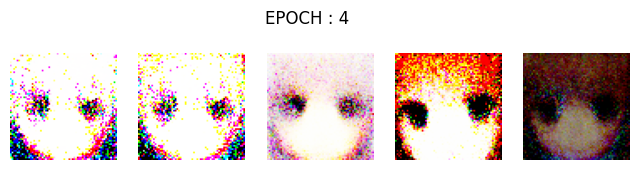

[Epoch: 5/200] [Batch: 348/348] [D loss: 0.241652] [G loss: 2.396756]
torch.Size([64, 3, 64, 64])


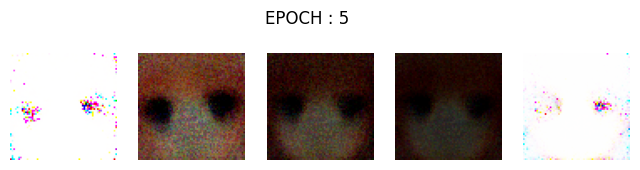

[Epoch: 6/200] [Batch: 348/348] [D loss: 0.142783] [G loss: 6.337280]
torch.Size([64, 3, 64, 64])


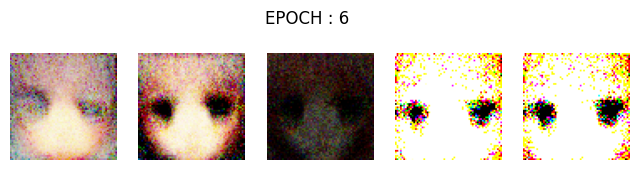

[Epoch: 7/200] [Batch: 348/348] [D loss: 0.097062] [G loss: 4.301087]
torch.Size([64, 3, 64, 64])


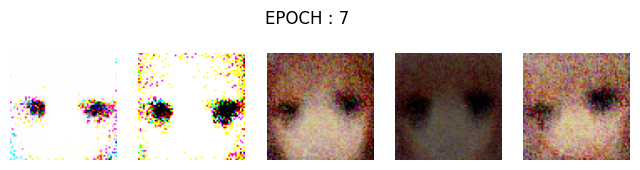

[Epoch: 8/200] [Batch: 348/348] [D loss: 0.204137] [G loss: 3.429933]
torch.Size([64, 3, 64, 64])


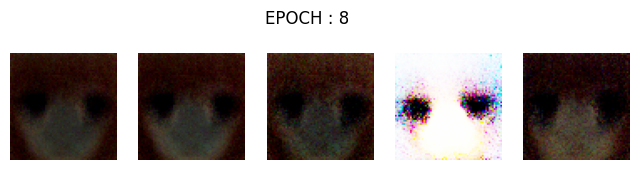

[Epoch: 9/200] [Batch: 348/348] [D loss: 0.195754] [G loss: 3.119937]
torch.Size([64, 3, 64, 64])


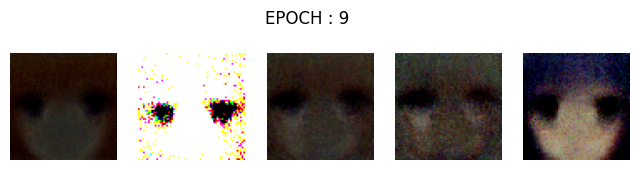

[Epoch: 10/200] [Batch: 348/348] [D loss: 0.200870] [G loss: 1.575118]
torch.Size([64, 3, 64, 64])


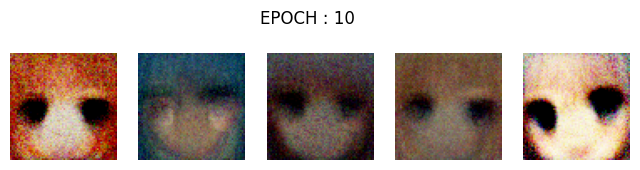

[Epoch: 11/200] [Batch: 348/348] [D loss: 0.242911] [G loss: 2.146027]
torch.Size([64, 3, 64, 64])


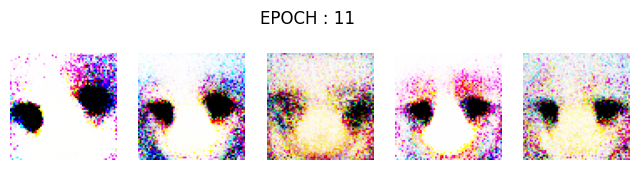

[Epoch: 12/200] [Batch: 348/348] [D loss: 0.592699] [G loss: 3.279537]
torch.Size([64, 3, 64, 64])


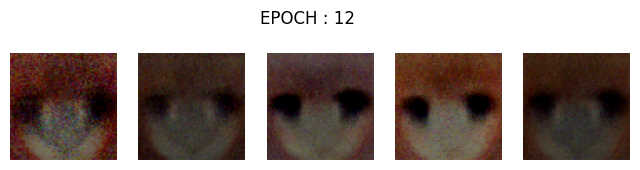

[Epoch: 13/200] [Batch: 348/348] [D loss: 0.183439] [G loss: 3.932992]
torch.Size([64, 3, 64, 64])


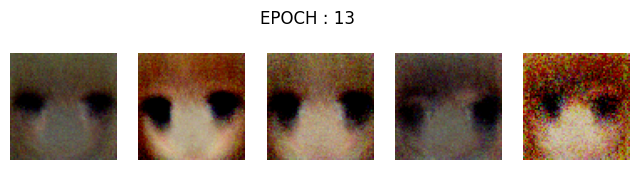

[Epoch: 14/200] [Batch: 348/348] [D loss: 0.210871] [G loss: 2.483163]
torch.Size([64, 3, 64, 64])


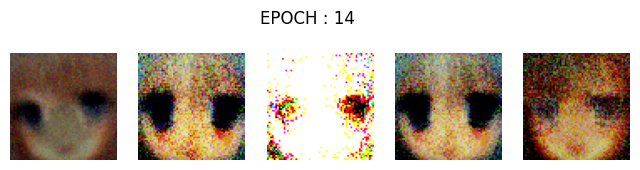

[Epoch: 15/200] [Batch: 348/348] [D loss: 0.125615] [G loss: 3.691951]
torch.Size([64, 3, 64, 64])


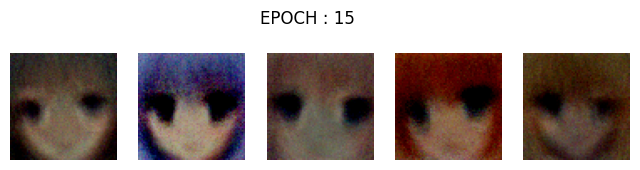

[Epoch: 16/200] [Batch: 348/348] [D loss: 0.188897] [G loss: 2.500707]
torch.Size([64, 3, 64, 64])


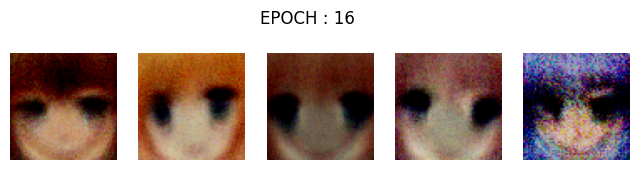

[Epoch: 17/200] [Batch: 348/348] [D loss: 0.304341] [G loss: 3.898340]
torch.Size([64, 3, 64, 64])


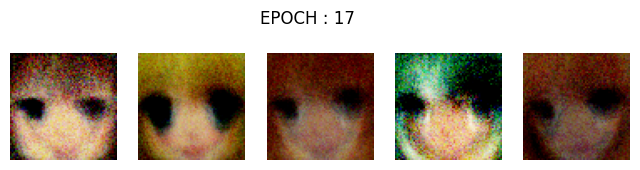

[Epoch: 18/200] [Batch: 348/348] [D loss: 0.183497] [G loss: 4.545969]
torch.Size([64, 3, 64, 64])


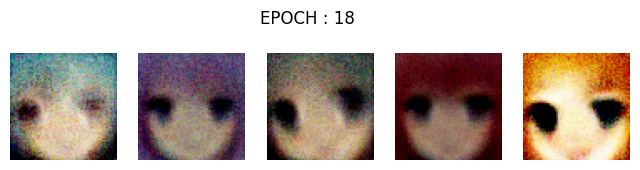

[Epoch: 19/200] [Batch: 348/348] [D loss: 0.184237] [G loss: 5.679179]
torch.Size([64, 3, 64, 64])


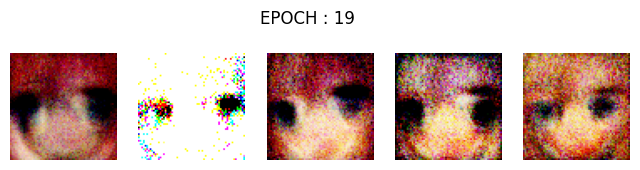

[Epoch: 20/200] [Batch: 348/348] [D loss: 0.155355] [G loss: 2.742535]
torch.Size([64, 3, 64, 64])


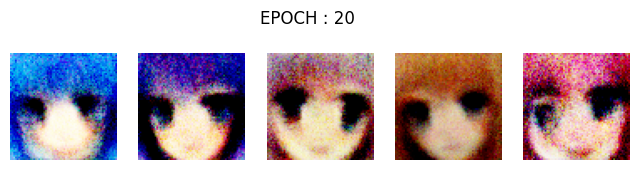

[Epoch: 21/200] [Batch: 348/348] [D loss: 0.257228] [G loss: 1.832166]
torch.Size([64, 3, 64, 64])


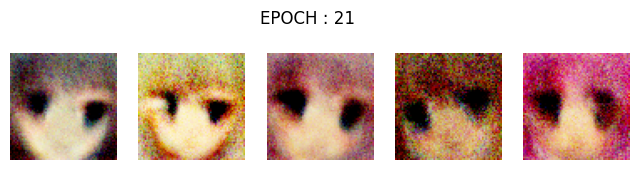

[Epoch: 22/200] [Batch: 348/348] [D loss: 0.160011] [G loss: 3.423597]
torch.Size([64, 3, 64, 64])


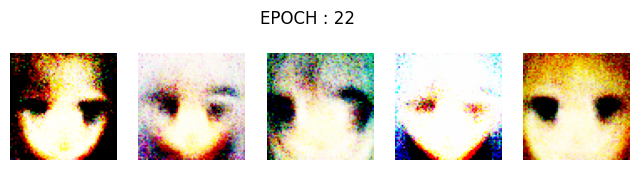

[Epoch: 23/200] [Batch: 348/348] [D loss: 0.194889] [G loss: 2.947154]
torch.Size([64, 3, 64, 64])


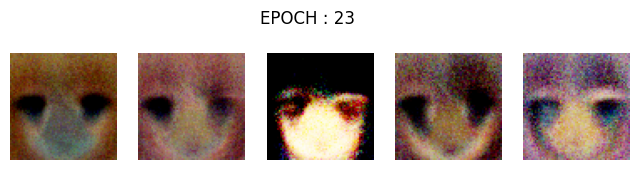

[Epoch: 24/200] [Batch: 348/348] [D loss: 0.146140] [G loss: 2.541035]
torch.Size([64, 3, 64, 64])


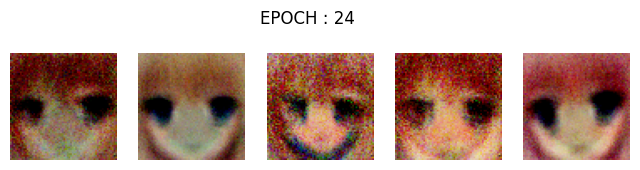

[Epoch: 25/200] [Batch: 348/348] [D loss: 0.233563] [G loss: 2.869813]
torch.Size([64, 3, 64, 64])


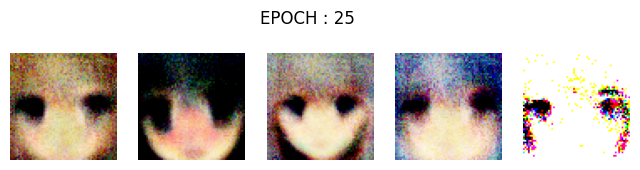

[Epoch: 26/200] [Batch: 348/348] [D loss: 0.264433] [G loss: 2.225217]
torch.Size([64, 3, 64, 64])


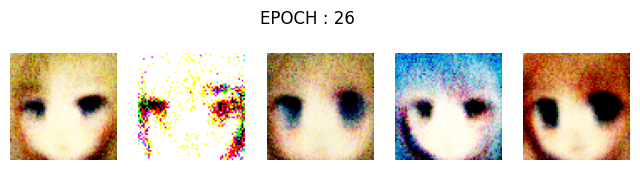

[Epoch: 27/200] [Batch: 348/348] [D loss: 0.274882] [G loss: 2.679809]
torch.Size([64, 3, 64, 64])


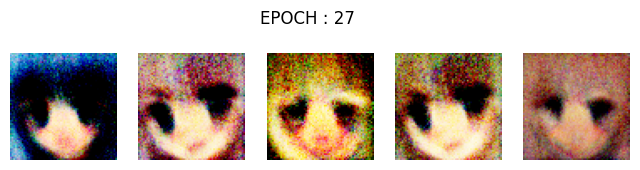

[Epoch: 28/200] [Batch: 348/348] [D loss: 0.269212] [G loss: 3.222629]
torch.Size([64, 3, 64, 64])


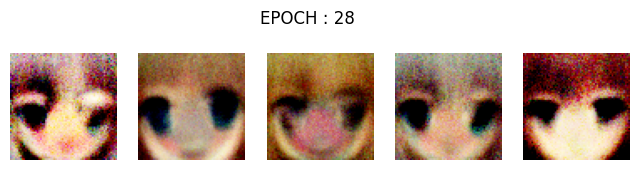

[Epoch: 29/200] [Batch: 348/348] [D loss: 0.329176] [G loss: 2.809556]
torch.Size([64, 3, 64, 64])


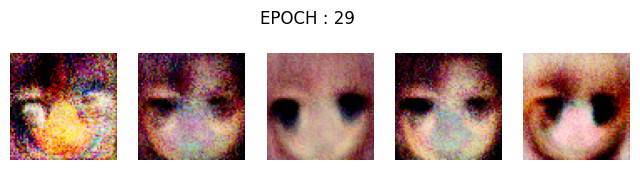

[Epoch: 30/200] [Batch: 348/348] [D loss: 0.123208] [G loss: 3.848083]
torch.Size([64, 3, 64, 64])


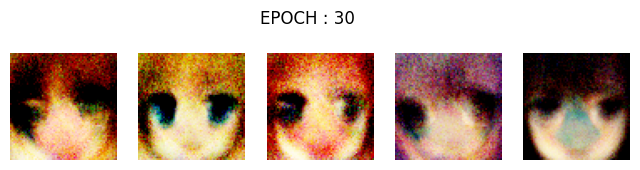

[Epoch: 31/200] [Batch: 348/348] [D loss: 0.270757] [G loss: 2.294601]
torch.Size([64, 3, 64, 64])


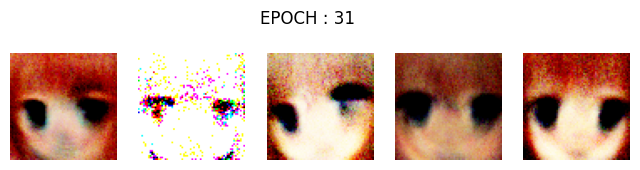

[Epoch: 32/200] [Batch: 348/348] [D loss: 0.164365] [G loss: 3.196030]
torch.Size([64, 3, 64, 64])


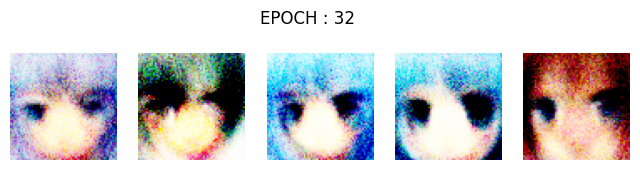

[Epoch: 33/200] [Batch: 348/348] [D loss: 0.285069] [G loss: 3.040942]
torch.Size([64, 3, 64, 64])


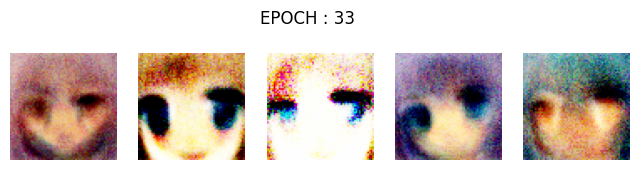

[Epoch: 34/200] [Batch: 348/348] [D loss: 0.100328] [G loss: 2.564900]
torch.Size([64, 3, 64, 64])


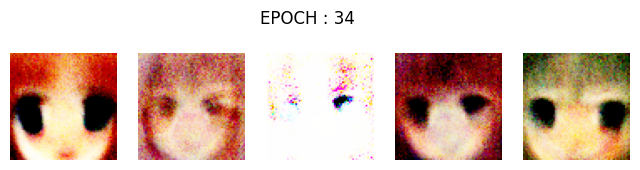

[Epoch: 35/200] [Batch: 348/348] [D loss: 0.179863] [G loss: 2.889328]
torch.Size([64, 3, 64, 64])


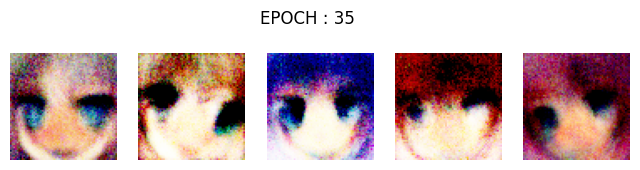

[Epoch: 36/200] [Batch: 348/348] [D loss: 0.217872] [G loss: 2.965503]
torch.Size([64, 3, 64, 64])


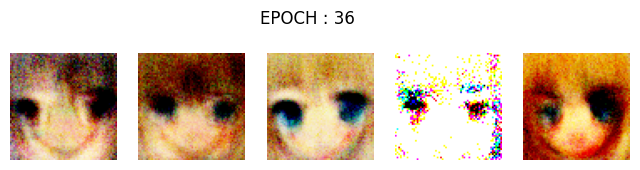

[Epoch: 37/200] [Batch: 348/348] [D loss: 0.358950] [G loss: 2.801819]
torch.Size([64, 3, 64, 64])


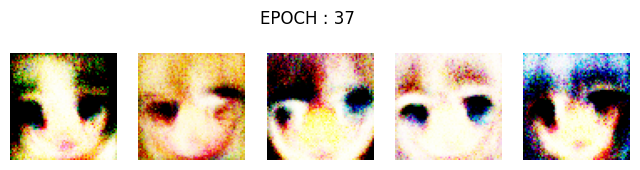

[Epoch: 38/200] [Batch: 348/348] [D loss: 0.136272] [G loss: 2.723719]
torch.Size([64, 3, 64, 64])


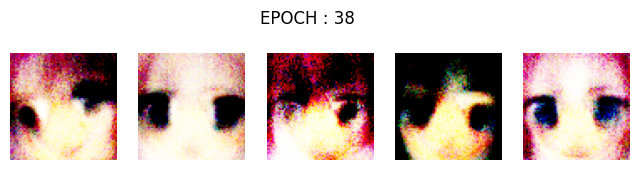

[Epoch: 39/200] [Batch: 348/348] [D loss: 0.164901] [G loss: 1.982898]
torch.Size([64, 3, 64, 64])


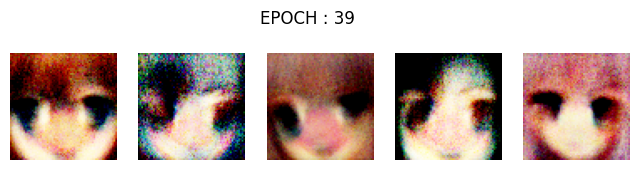

[Epoch: 40/200] [Batch: 348/348] [D loss: 0.150492] [G loss: 2.831981]
torch.Size([64, 3, 64, 64])


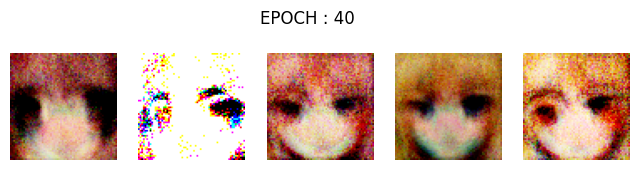

[Epoch: 41/200] [Batch: 348/348] [D loss: 0.176671] [G loss: 5.248612]
torch.Size([64, 3, 64, 64])


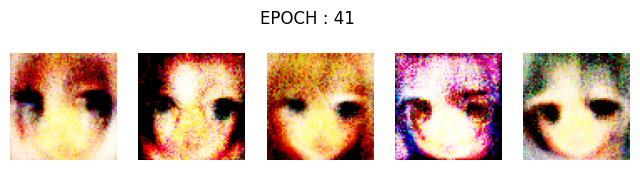

[Epoch: 42/200] [Batch: 348/348] [D loss: 0.289815] [G loss: 2.589210]
torch.Size([64, 3, 64, 64])


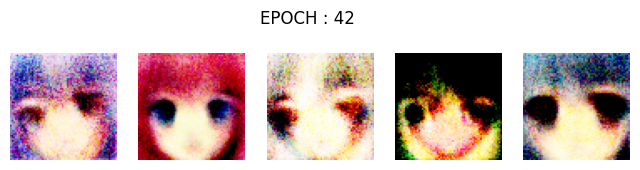

[Epoch: 43/200] [Batch: 348/348] [D loss: 0.190299] [G loss: 2.826004]
torch.Size([64, 3, 64, 64])


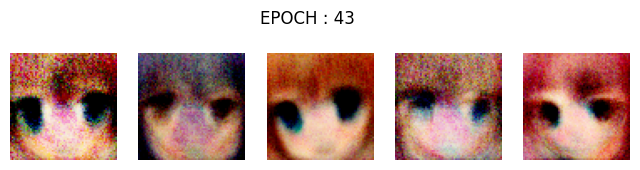

[Epoch: 44/200] [Batch: 348/348] [D loss: 0.426011] [G loss: 2.474471]
torch.Size([64, 3, 64, 64])


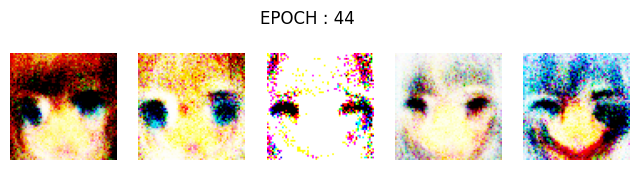

[Epoch: 45/200] [Batch: 348/348] [D loss: 0.103417] [G loss: 3.001013]
torch.Size([64, 3, 64, 64])


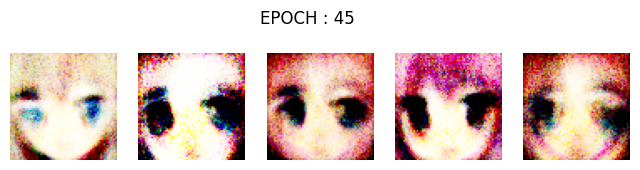

[Epoch: 46/200] [Batch: 348/348] [D loss: 0.196287] [G loss: 3.182280]
torch.Size([64, 3, 64, 64])


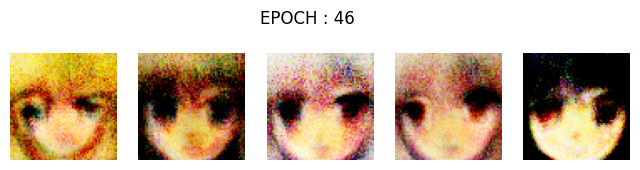

[Epoch: 47/200] [Batch: 348/348] [D loss: 0.098640] [G loss: 2.626973]
torch.Size([64, 3, 64, 64])


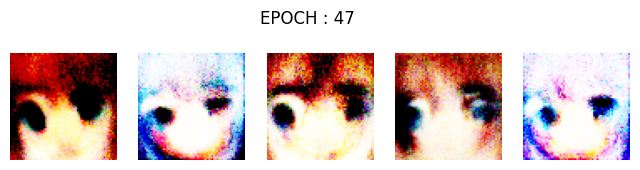

[Epoch: 48/200] [Batch: 348/348] [D loss: 0.277481] [G loss: 4.929583]
torch.Size([64, 3, 64, 64])


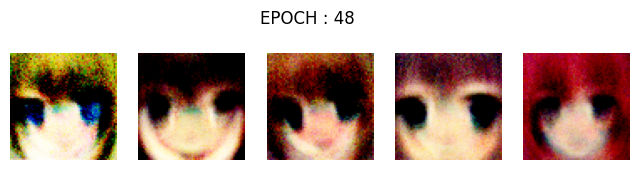

[Epoch: 49/200] [Batch: 348/348] [D loss: 0.272646] [G loss: 7.030871]
torch.Size([64, 3, 64, 64])


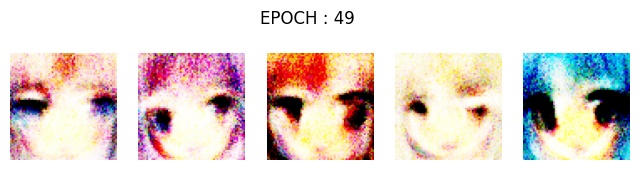

[Epoch: 50/200] [Batch: 348/348] [D loss: 0.179995] [G loss: 2.711209]
torch.Size([64, 3, 64, 64])


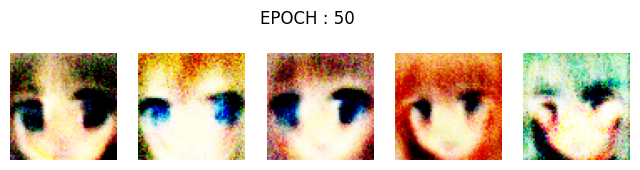

[Epoch: 51/200] [Batch: 348/348] [D loss: 0.228825] [G loss: 4.095100]
torch.Size([64, 3, 64, 64])


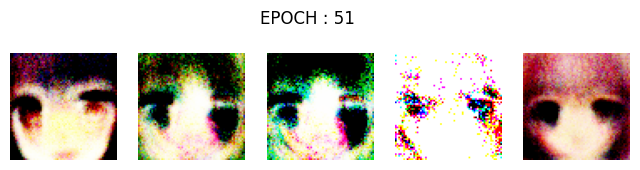

[Epoch: 52/200] [Batch: 348/348] [D loss: 0.212419] [G loss: 3.808263]
torch.Size([64, 3, 64, 64])


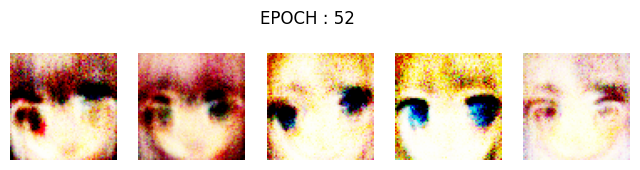

[Epoch: 53/200] [Batch: 348/348] [D loss: 0.227724] [G loss: 2.727066]
torch.Size([64, 3, 64, 64])


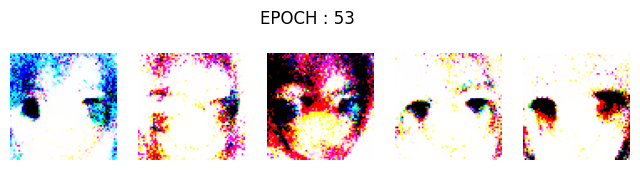

[Epoch: 54/200] [Batch: 348/348] [D loss: 0.127084] [G loss: 3.263622]
torch.Size([64, 3, 64, 64])


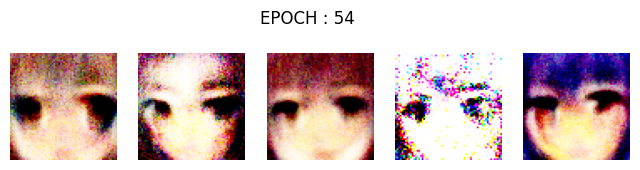

[Epoch: 55/200] [Batch: 348/348] [D loss: 0.212490] [G loss: 3.373929]
torch.Size([64, 3, 64, 64])


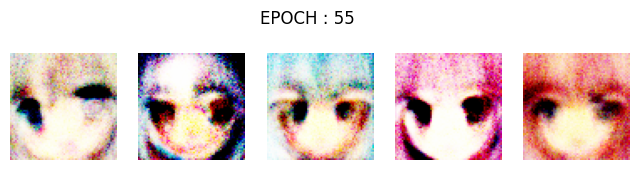

[Epoch: 56/200] [Batch: 348/348] [D loss: 0.110773] [G loss: 3.073433]
torch.Size([64, 3, 64, 64])


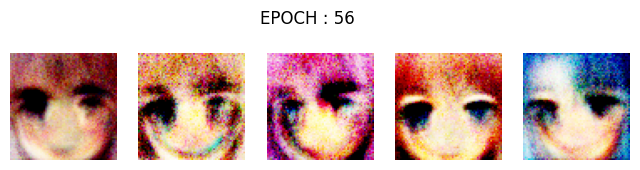

[Epoch: 57/200] [Batch: 348/348] [D loss: 0.139577] [G loss: 2.845645]
torch.Size([64, 3, 64, 64])


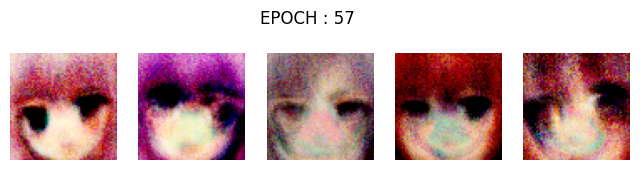

[Epoch: 58/200] [Batch: 348/348] [D loss: 0.177954] [G loss: 3.441545]
torch.Size([64, 3, 64, 64])


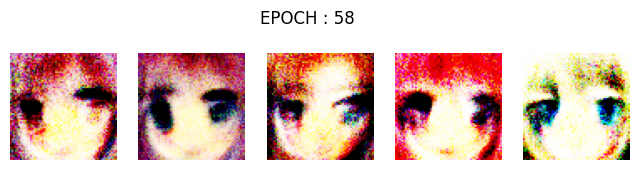

[Epoch: 59/200] [Batch: 348/348] [D loss: 0.143940] [G loss: 3.113274]
torch.Size([64, 3, 64, 64])


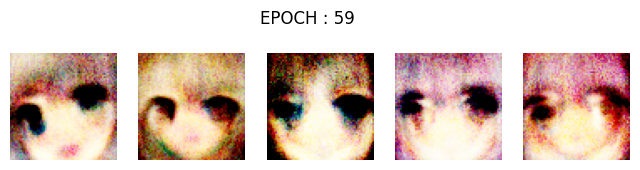

[Epoch: 60/200] [Batch: 348/348] [D loss: 0.170274] [G loss: 2.999478]
torch.Size([64, 3, 64, 64])


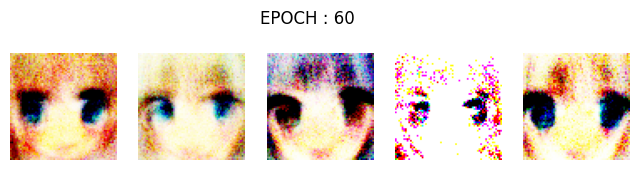

[Epoch: 61/200] [Batch: 348/348] [D loss: 0.040623] [G loss: 3.683258]
torch.Size([64, 3, 64, 64])


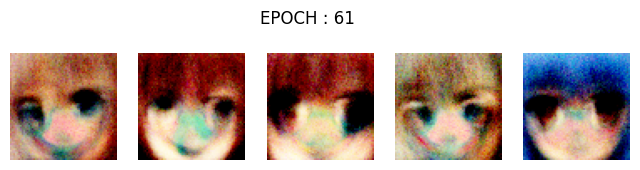

[Epoch: 62/200] [Batch: 348/348] [D loss: 0.473397] [G loss: 4.700806]
torch.Size([64, 3, 64, 64])


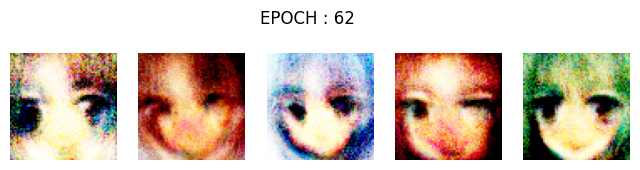

[Epoch: 63/200] [Batch: 348/348] [D loss: 0.130951] [G loss: 2.869134]
torch.Size([64, 3, 64, 64])


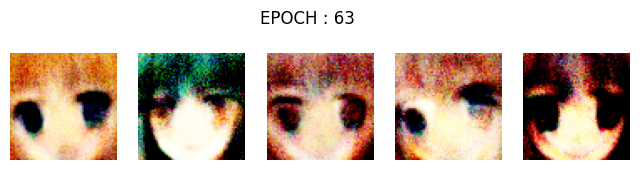

[Epoch: 64/200] [Batch: 348/348] [D loss: 0.116421] [G loss: 3.123386]
torch.Size([64, 3, 64, 64])


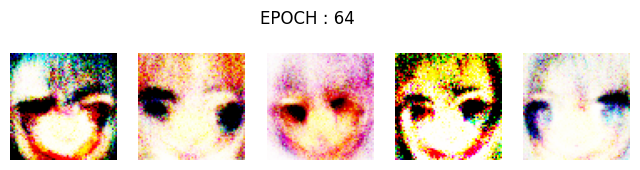

[Epoch: 65/200] [Batch: 348/348] [D loss: 0.192688] [G loss: 3.456477]
torch.Size([64, 3, 64, 64])


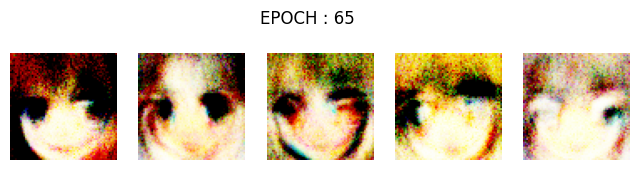

[Epoch: 66/200] [Batch: 348/348] [D loss: 0.233374] [G loss: 3.783674]
torch.Size([64, 3, 64, 64])


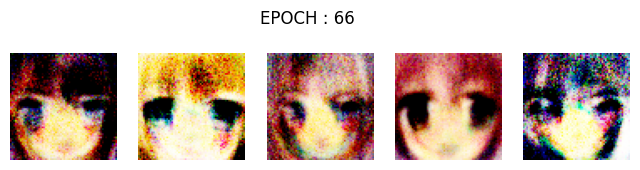

[Epoch: 67/200] [Batch: 348/348] [D loss: 0.212215] [G loss: 3.360512]
torch.Size([64, 3, 64, 64])


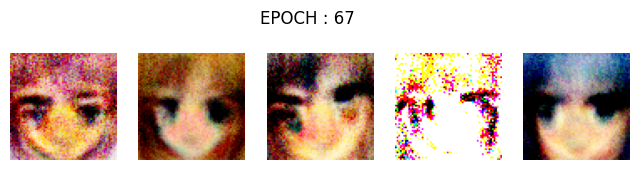

[Epoch: 68/200] [Batch: 348/348] [D loss: 0.158746] [G loss: 4.592492]
torch.Size([64, 3, 64, 64])


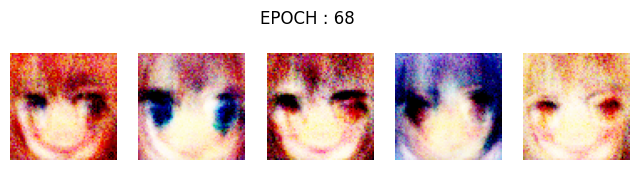

[Epoch: 69/200] [Batch: 348/348] [D loss: 0.125623] [G loss: 3.186137]
torch.Size([64, 3, 64, 64])


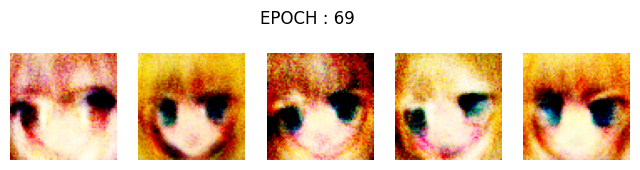

[Epoch: 70/200] [Batch: 348/348] [D loss: 0.359826] [G loss: 5.177078]
torch.Size([64, 3, 64, 64])


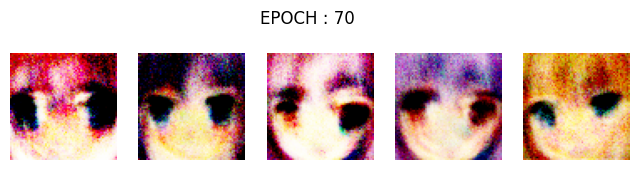

[Epoch: 71/200] [Batch: 348/348] [D loss: 0.118869] [G loss: 4.988608]
torch.Size([64, 3, 64, 64])


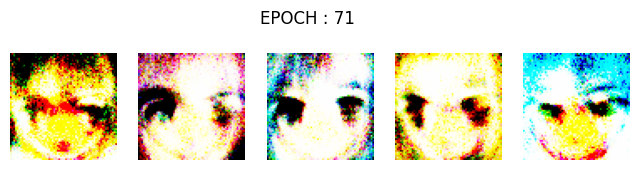

[Epoch: 72/200] [Batch: 348/348] [D loss: 0.218056] [G loss: 3.169106]
torch.Size([64, 3, 64, 64])


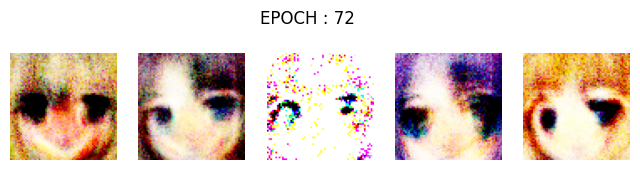

[Epoch: 73/200] [Batch: 348/348] [D loss: 0.148396] [G loss: 3.145165]
torch.Size([64, 3, 64, 64])


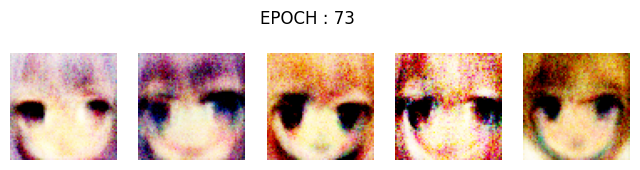

[Epoch: 74/200] [Batch: 348/348] [D loss: 0.107623] [G loss: 5.207884]
torch.Size([64, 3, 64, 64])


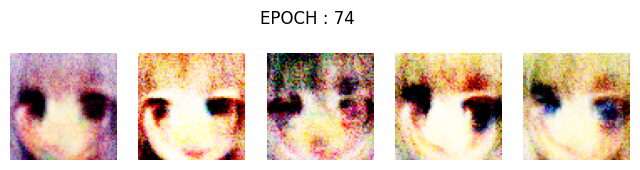

[Epoch: 75/200] [Batch: 348/348] [D loss: 0.065714] [G loss: 3.190544]
torch.Size([64, 3, 64, 64])


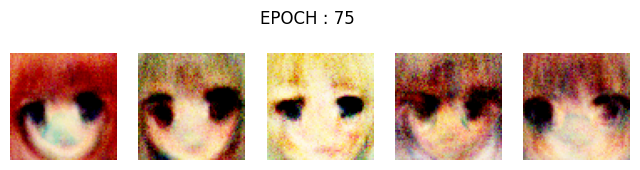

[Epoch: 76/200] [Batch: 348/348] [D loss: 0.110004] [G loss: 3.462629]
torch.Size([64, 3, 64, 64])


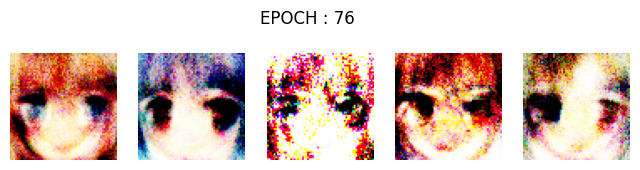

[Epoch: 77/200] [Batch: 348/348] [D loss: 0.087326] [G loss: 3.484623]
torch.Size([64, 3, 64, 64])


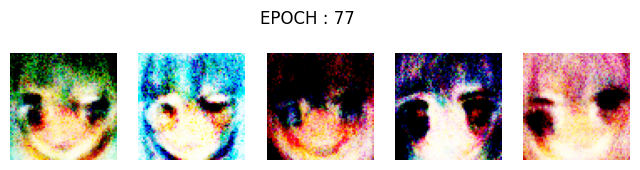

[Epoch: 78/200] [Batch: 348/348] [D loss: 0.077451] [G loss: 3.380286]
torch.Size([64, 3, 64, 64])


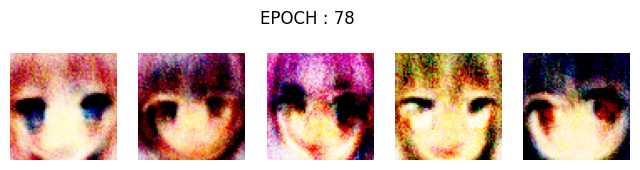

[Epoch: 79/200] [Batch: 348/348] [D loss: 0.129249] [G loss: 3.450511]
torch.Size([64, 3, 64, 64])


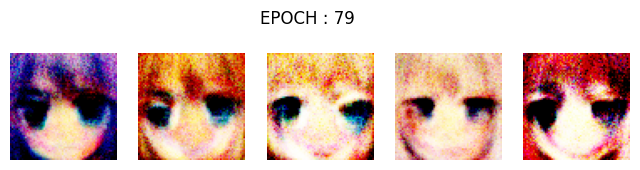

[Epoch: 80/200] [Batch: 348/348] [D loss: 0.122756] [G loss: 6.459330]
torch.Size([64, 3, 64, 64])


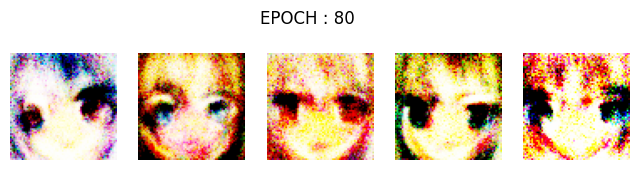

[Epoch: 81/200] [Batch: 348/348] [D loss: 0.179395] [G loss: 3.414206]
torch.Size([64, 3, 64, 64])


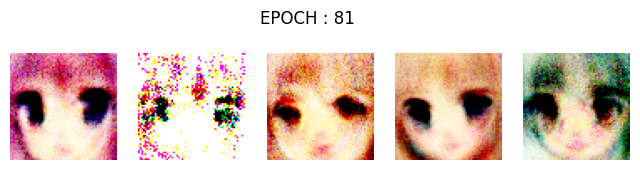

[Epoch: 82/200] [Batch: 348/348] [D loss: 0.150655] [G loss: 2.808411]
torch.Size([64, 3, 64, 64])


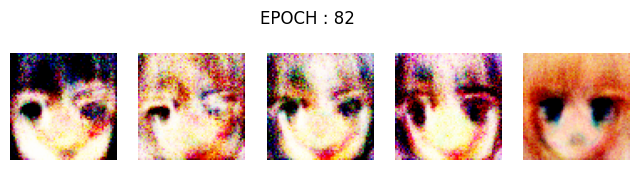

[Epoch: 83/200] [Batch: 348/348] [D loss: 0.335650] [G loss: 3.129123]
torch.Size([64, 3, 64, 64])


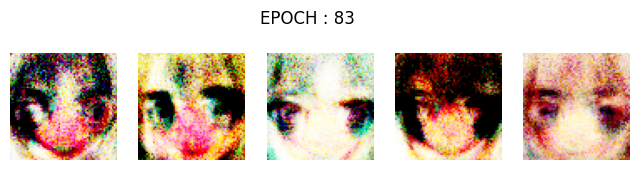

[Epoch: 84/200] [Batch: 348/348] [D loss: 0.234430] [G loss: 4.207807]
torch.Size([64, 3, 64, 64])


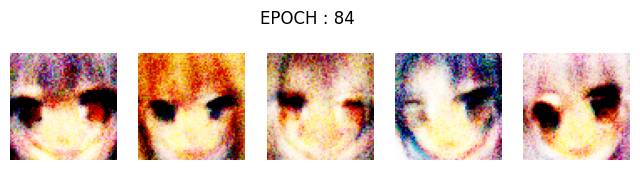

[Epoch: 85/200] [Batch: 348/348] [D loss: 0.178190] [G loss: 4.052959]
torch.Size([64, 3, 64, 64])


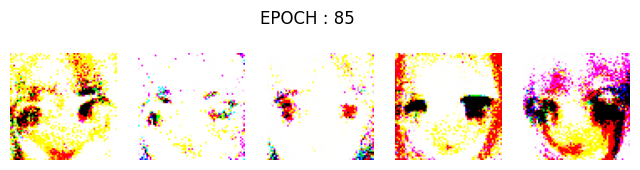

[Epoch: 86/200] [Batch: 348/348] [D loss: 0.328190] [G loss: 3.366655]
torch.Size([64, 3, 64, 64])


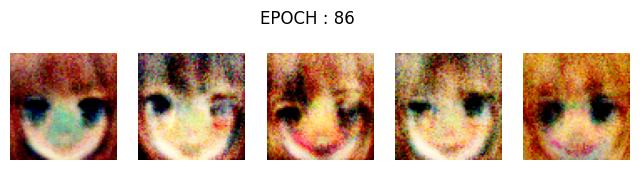

[Epoch: 87/200] [Batch: 348/348] [D loss: 0.162163] [G loss: 3.427570]
torch.Size([64, 3, 64, 64])


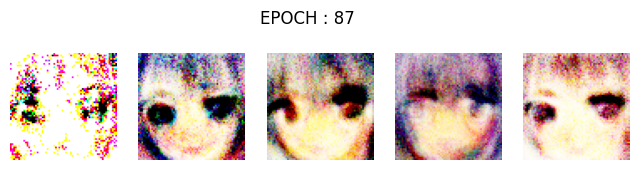

[Epoch: 88/200] [Batch: 348/348] [D loss: 0.209772] [G loss: 3.259169]
torch.Size([64, 3, 64, 64])


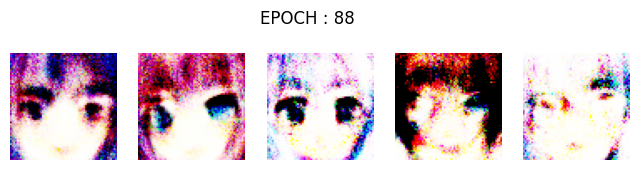

[Epoch: 89/200] [Batch: 348/348] [D loss: 0.161901] [G loss: 3.302785]
torch.Size([64, 3, 64, 64])


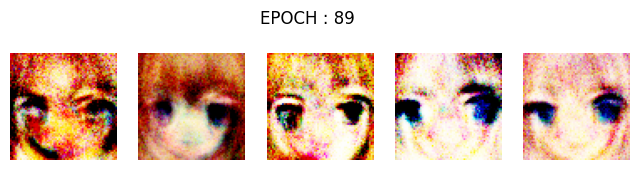

[Epoch: 90/200] [Batch: 348/348] [D loss: 0.138404] [G loss: 3.218504]
torch.Size([64, 3, 64, 64])


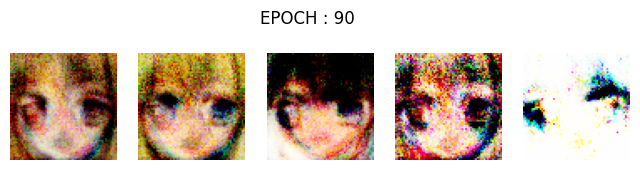

[Epoch: 91/200] [Batch: 348/348] [D loss: 0.077449] [G loss: 3.742573]
torch.Size([64, 3, 64, 64])


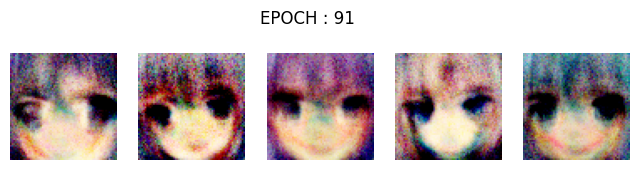

[Epoch: 92/200] [Batch: 348/348] [D loss: 0.047444] [G loss: 3.441122]
torch.Size([64, 3, 64, 64])


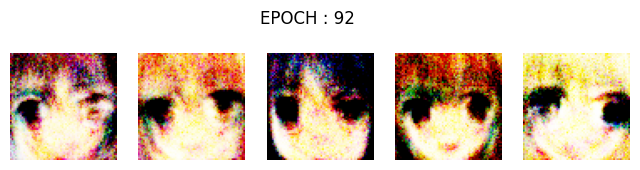

[Epoch: 93/200] [Batch: 348/348] [D loss: 0.122396] [G loss: 4.126685]
torch.Size([64, 3, 64, 64])


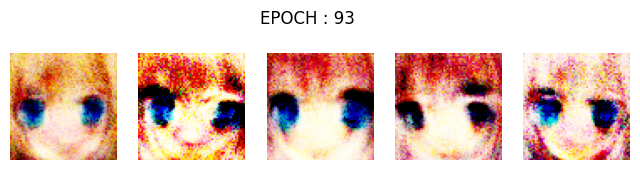

[Epoch: 94/200] [Batch: 348/348] [D loss: 0.193768] [G loss: 4.077064]
torch.Size([64, 3, 64, 64])


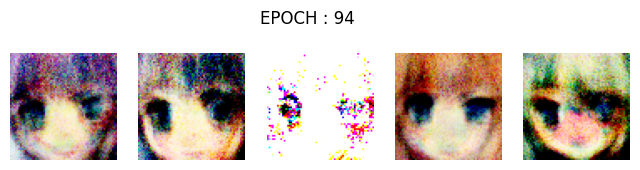

[Epoch: 95/200] [Batch: 348/348] [D loss: 0.092093] [G loss: 4.554214]
torch.Size([64, 3, 64, 64])


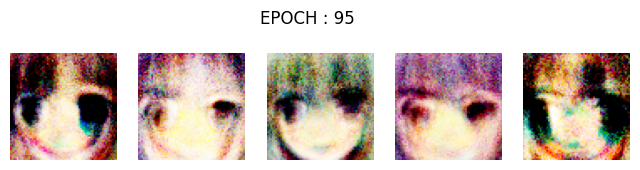

[Epoch: 96/200] [Batch: 348/348] [D loss: 0.100413] [G loss: 3.549112]
torch.Size([64, 3, 64, 64])


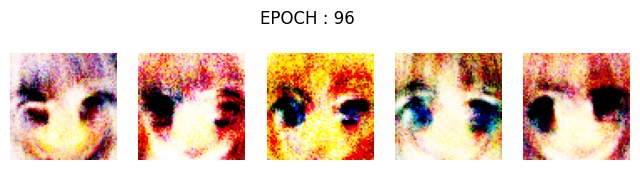

[Epoch: 97/200] [Batch: 348/348] [D loss: 0.212438] [G loss: 4.356001]
torch.Size([64, 3, 64, 64])


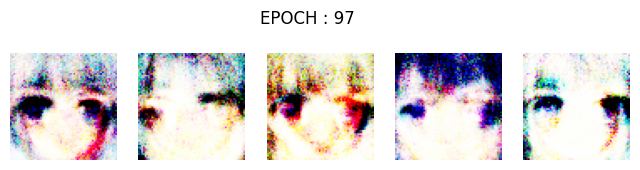

[Epoch: 98/200] [Batch: 348/348] [D loss: 0.142726] [G loss: 3.818321]
torch.Size([64, 3, 64, 64])


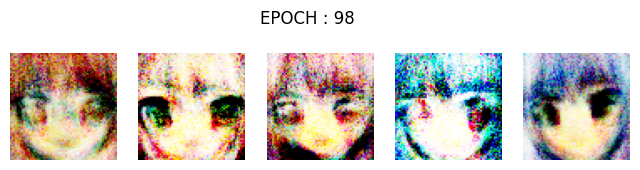

[Epoch: 99/200] [Batch: 348/348] [D loss: 0.278113] [G loss: 4.805055]
torch.Size([64, 3, 64, 64])


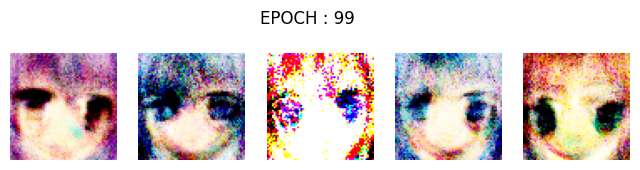

[Epoch: 100/200] [Batch: 348/348] [D loss: 0.119117] [G loss: 3.582848]
torch.Size([64, 3, 64, 64])


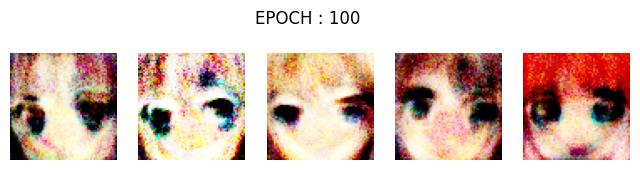

[Epoch: 101/200] [Batch: 348/348] [D loss: 0.144068] [G loss: 5.000236]
torch.Size([64, 3, 64, 64])


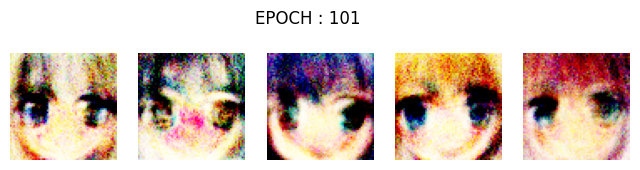

[Epoch: 102/200] [Batch: 348/348] [D loss: 0.110789] [G loss: 3.741805]
torch.Size([64, 3, 64, 64])


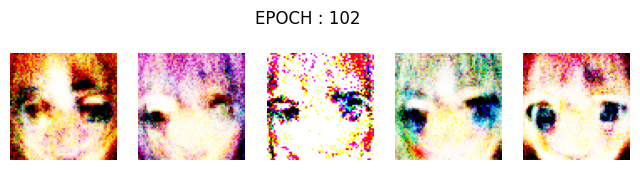

[Epoch: 103/200] [Batch: 348/348] [D loss: 0.100290] [G loss: 3.940673]
torch.Size([64, 3, 64, 64])


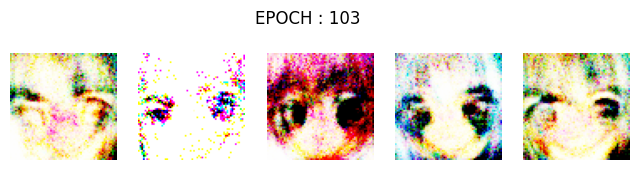

[Epoch: 104/200] [Batch: 348/348] [D loss: 0.030818] [G loss: 4.552077]
torch.Size([64, 3, 64, 64])


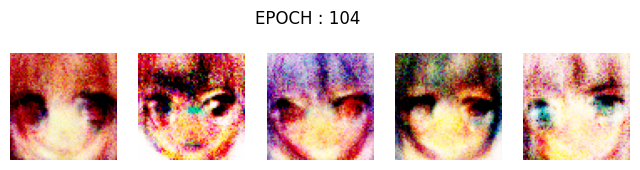

[Epoch: 105/200] [Batch: 348/348] [D loss: 0.191620] [G loss: 5.728136]
torch.Size([64, 3, 64, 64])


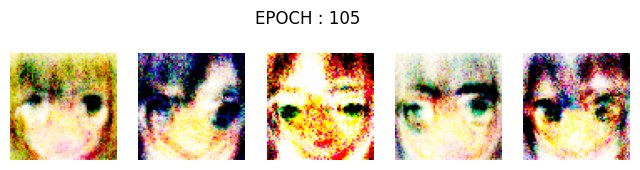

[Epoch: 106/200] [Batch: 348/348] [D loss: 0.133406] [G loss: 2.695406]
torch.Size([64, 3, 64, 64])


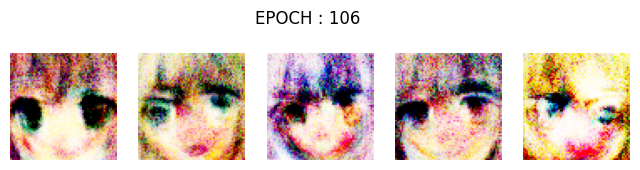

[Epoch: 107/200] [Batch: 348/348] [D loss: 0.073773] [G loss: 5.674625]
torch.Size([64, 3, 64, 64])


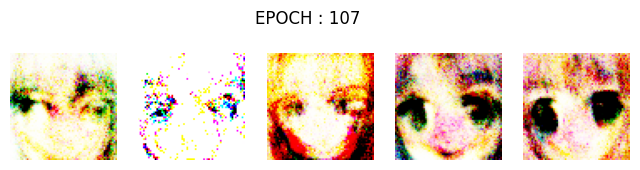

[Epoch: 108/200] [Batch: 348/348] [D loss: 0.133984] [G loss: 6.802622]
torch.Size([64, 3, 64, 64])


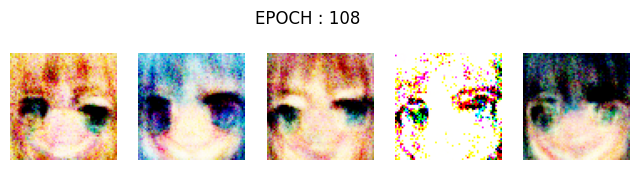

[Epoch: 109/200] [Batch: 348/348] [D loss: 0.224050] [G loss: 4.288263]
torch.Size([64, 3, 64, 64])


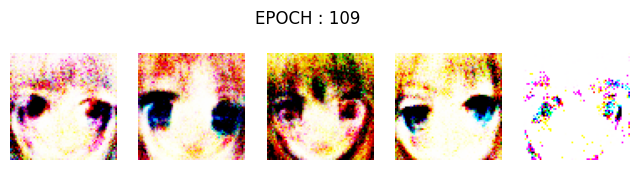

[Epoch: 110/200] [Batch: 348/348] [D loss: 0.106025] [G loss: 3.905709]
torch.Size([64, 3, 64, 64])


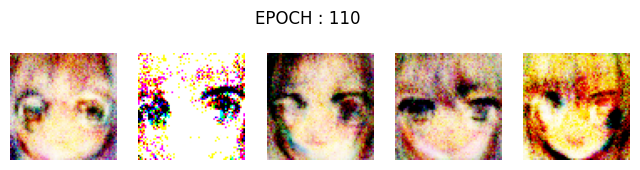

[Epoch: 111/200] [Batch: 348/348] [D loss: 0.128979] [G loss: 3.808789]
torch.Size([64, 3, 64, 64])


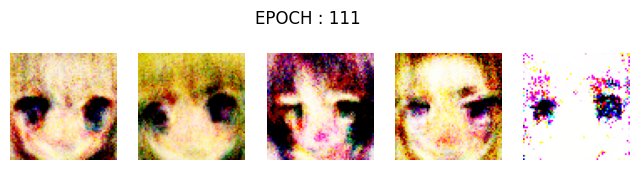

[Epoch: 112/200] [Batch: 348/348] [D loss: 0.244940] [G loss: 3.319511]
torch.Size([64, 3, 64, 64])


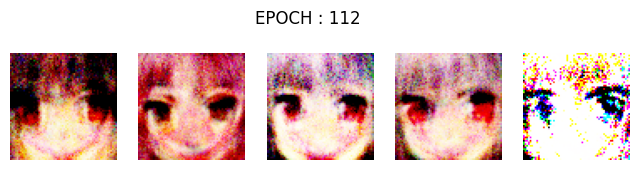

[Epoch: 113/200] [Batch: 348/348] [D loss: 0.113348] [G loss: 4.243411]
torch.Size([64, 3, 64, 64])


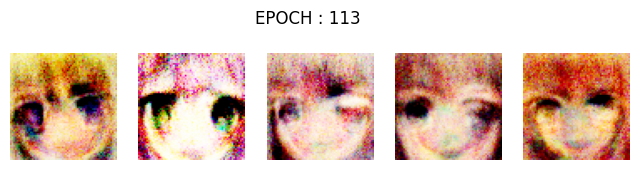

[Epoch: 114/200] [Batch: 348/348] [D loss: 0.115917] [G loss: 3.853401]
torch.Size([64, 3, 64, 64])


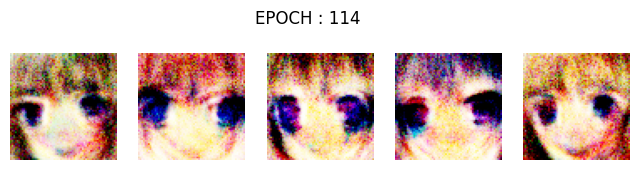

[Epoch: 115/200] [Batch: 348/348] [D loss: 0.058671] [G loss: 4.136208]
torch.Size([64, 3, 64, 64])


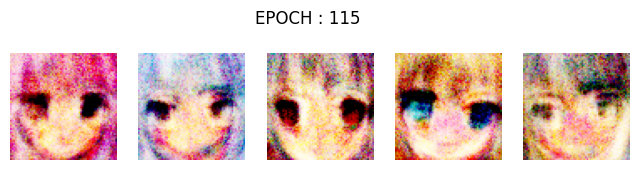

[Epoch: 116/200] [Batch: 348/348] [D loss: 0.167323] [G loss: 3.722922]
torch.Size([64, 3, 64, 64])


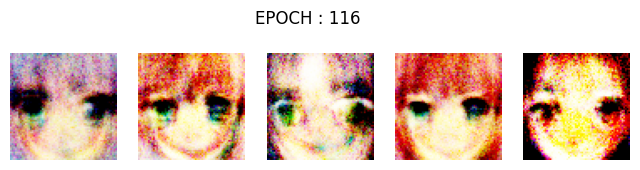

[Epoch: 117/200] [Batch: 348/348] [D loss: 0.109134] [G loss: 3.765848]
torch.Size([64, 3, 64, 64])


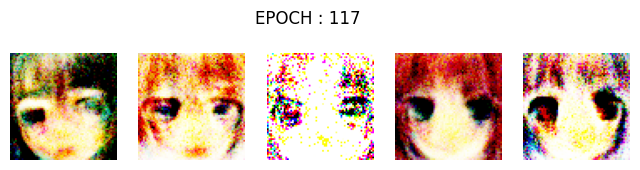

[Epoch: 118/200] [Batch: 348/348] [D loss: 0.176881] [G loss: 4.661286]
torch.Size([64, 3, 64, 64])


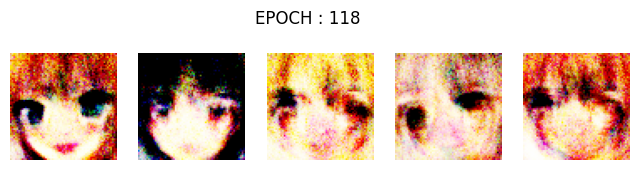

[Epoch: 119/200] [Batch: 348/348] [D loss: 0.048751] [G loss: 4.421197]
torch.Size([64, 3, 64, 64])


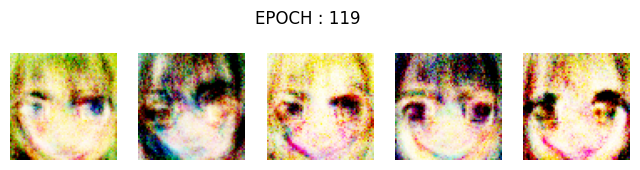

[Epoch: 120/200] [Batch: 348/348] [D loss: 0.133458] [G loss: 3.786516]
torch.Size([64, 3, 64, 64])


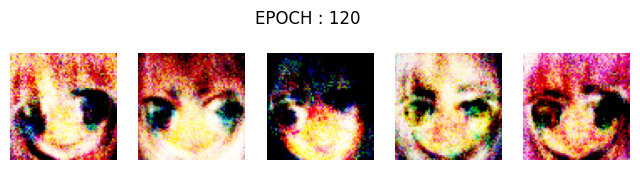

[Epoch: 121/200] [Batch: 348/348] [D loss: 0.044097] [G loss: 4.115909]
torch.Size([64, 3, 64, 64])


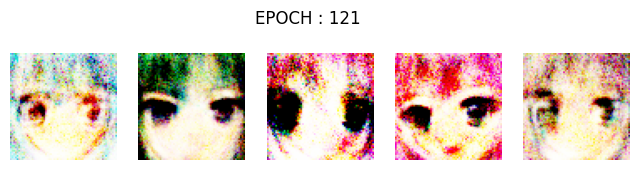

[Epoch: 122/200] [Batch: 348/348] [D loss: 0.088966] [G loss: 4.783073]
torch.Size([64, 3, 64, 64])


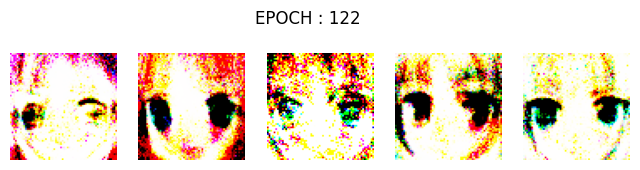

[Epoch: 123/200] [Batch: 348/348] [D loss: 0.043947] [G loss: 3.086833]
torch.Size([64, 3, 64, 64])


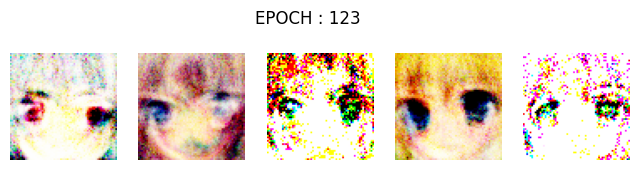

[Epoch: 124/200] [Batch: 348/348] [D loss: 0.106442] [G loss: 3.570788]
torch.Size([64, 3, 64, 64])


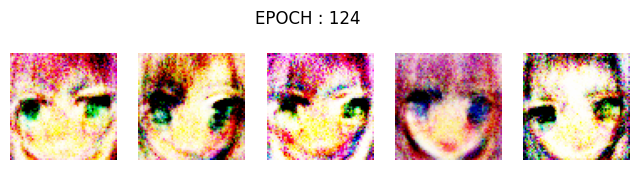

[Epoch: 125/200] [Batch: 348/348] [D loss: 0.079621] [G loss: 6.328917]
torch.Size([64, 3, 64, 64])


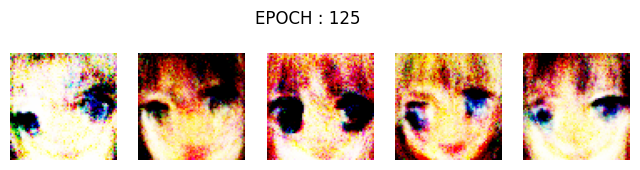

[Epoch: 126/200] [Batch: 348/348] [D loss: 0.096030] [G loss: 4.941525]
torch.Size([64, 3, 64, 64])


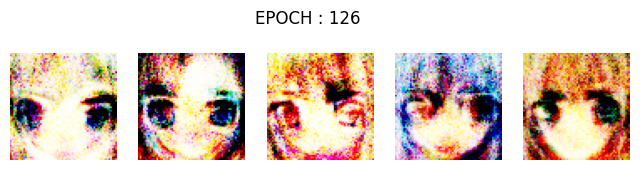

[Epoch: 127/200] [Batch: 348/348] [D loss: 0.072300] [G loss: 6.489727]
torch.Size([64, 3, 64, 64])


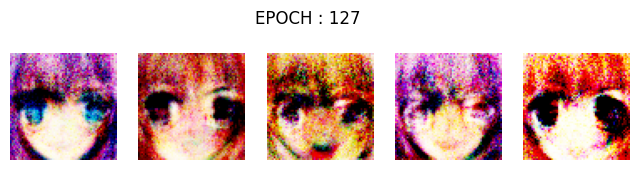

[Epoch: 128/200] [Batch: 348/348] [D loss: 0.252190] [G loss: 4.830927]
torch.Size([64, 3, 64, 64])


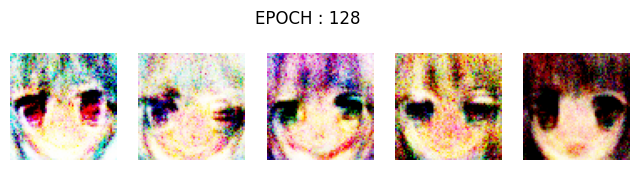

[Epoch: 129/200] [Batch: 348/348] [D loss: 0.088019] [G loss: 4.999887]
torch.Size([64, 3, 64, 64])


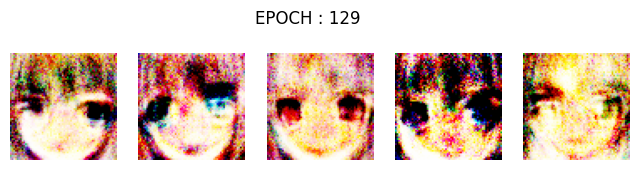

[Epoch: 130/200] [Batch: 348/348] [D loss: 0.089606] [G loss: 5.419298]
torch.Size([64, 3, 64, 64])


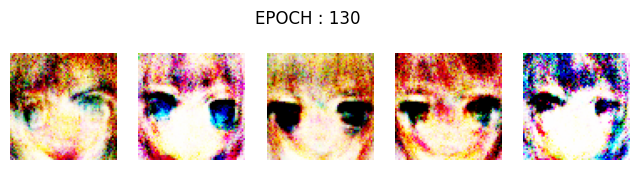

[Epoch: 131/200] [Batch: 348/348] [D loss: 0.144735] [G loss: 5.092200]
torch.Size([64, 3, 64, 64])


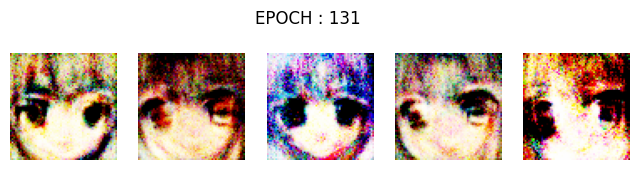

[Epoch: 132/200] [Batch: 348/348] [D loss: 0.252713] [G loss: 4.559613]
torch.Size([64, 3, 64, 64])


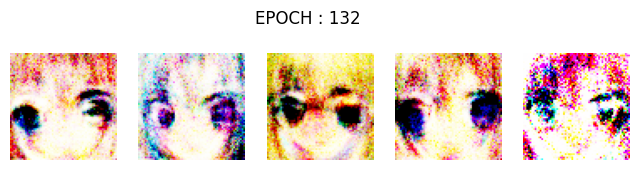

[Epoch: 133/200] [Batch: 348/348] [D loss: 0.223418] [G loss: 3.666373]
torch.Size([64, 3, 64, 64])


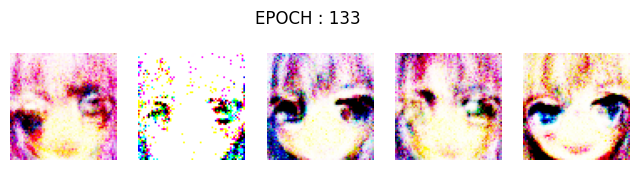

[Epoch: 134/200] [Batch: 348/348] [D loss: 0.101817] [G loss: 5.876832]
torch.Size([64, 3, 64, 64])


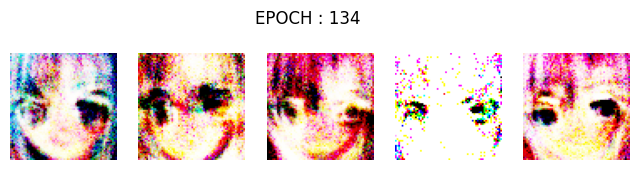

[Epoch: 135/200] [Batch: 348/348] [D loss: 0.211311] [G loss: 7.941870]
torch.Size([64, 3, 64, 64])


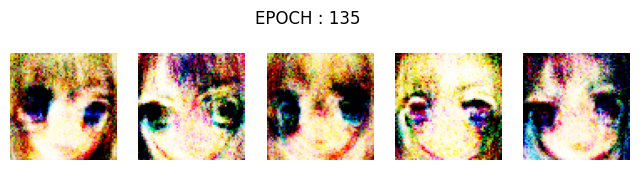

[Epoch: 136/200] [Batch: 348/348] [D loss: 0.107711] [G loss: 4.682151]
torch.Size([64, 3, 64, 64])


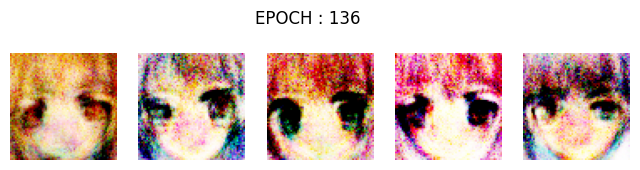

[Epoch: 137/200] [Batch: 348/348] [D loss: 0.318134] [G loss: 4.884507]
torch.Size([64, 3, 64, 64])


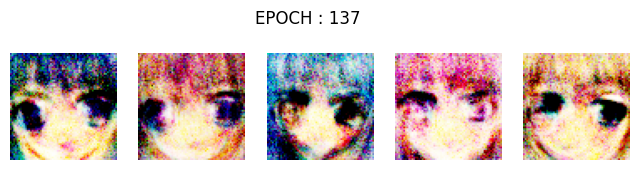

[Epoch: 138/200] [Batch: 348/348] [D loss: 0.133358] [G loss: 4.332561]
torch.Size([64, 3, 64, 64])


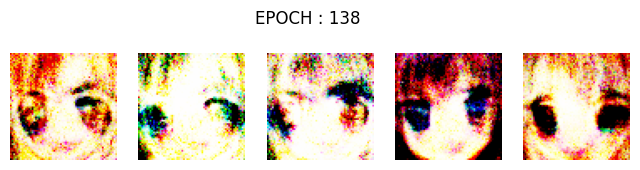

[Epoch: 139/200] [Batch: 348/348] [D loss: 0.272817] [G loss: 4.548649]
torch.Size([64, 3, 64, 64])


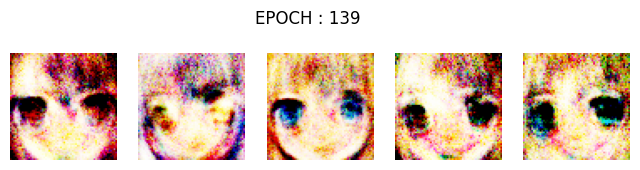

[Epoch: 140/200] [Batch: 348/348] [D loss: 0.031662] [G loss: 4.330619]
torch.Size([64, 3, 64, 64])


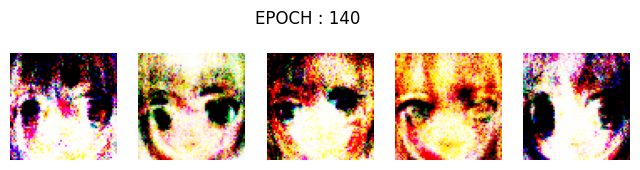

[Epoch: 141/200] [Batch: 348/348] [D loss: 0.172256] [G loss: 3.794698]
torch.Size([64, 3, 64, 64])


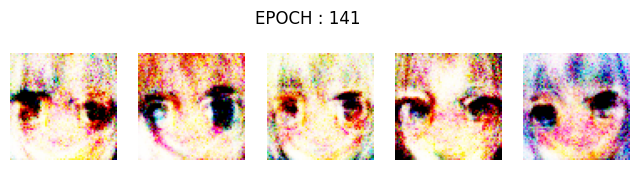

[Epoch: 142/200] [Batch: 348/348] [D loss: 0.185323] [G loss: 5.231797]
torch.Size([64, 3, 64, 64])


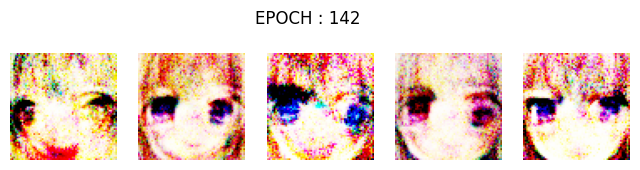

[Epoch: 143/200] [Batch: 348/348] [D loss: 0.041153] [G loss: 4.231167]
torch.Size([64, 3, 64, 64])


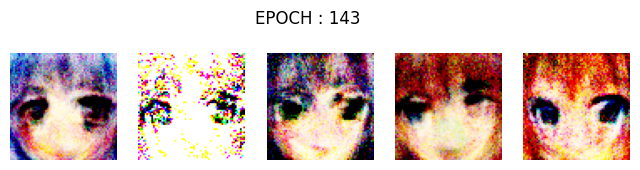

[Epoch: 144/200] [Batch: 348/348] [D loss: 0.236831] [G loss: 4.889349]
torch.Size([64, 3, 64, 64])


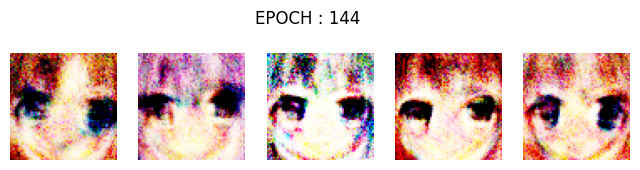

[Epoch: 145/200] [Batch: 348/348] [D loss: 0.046730] [G loss: 7.133576]
torch.Size([64, 3, 64, 64])


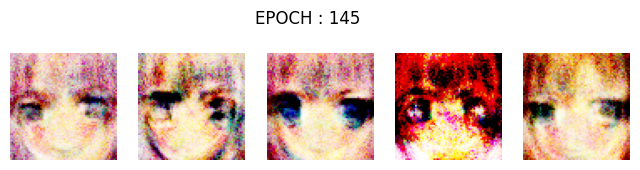

[Epoch: 146/200] [Batch: 348/348] [D loss: 0.035748] [G loss: 4.479313]
torch.Size([64, 3, 64, 64])


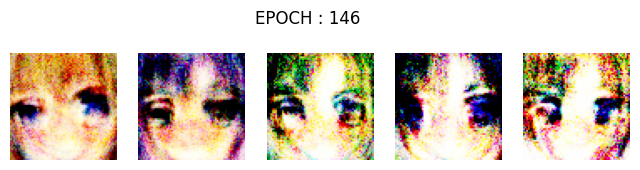

[Epoch: 147/200] [Batch: 348/348] [D loss: 0.088341] [G loss: 6.905082]
torch.Size([64, 3, 64, 64])


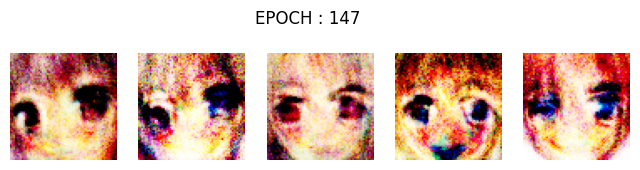

[Epoch: 148/200] [Batch: 348/348] [D loss: 1.010919] [G loss: 5.713120]
torch.Size([64, 3, 64, 64])


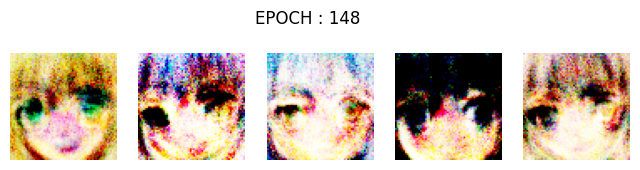

[Epoch: 149/200] [Batch: 348/348] [D loss: 0.159107] [G loss: 5.811705]
torch.Size([64, 3, 64, 64])


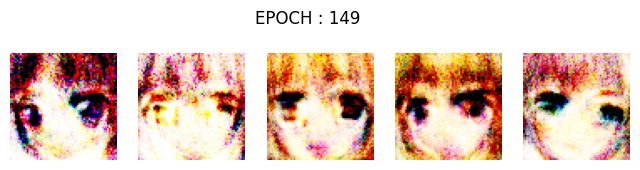

[Epoch: 150/200] [Batch: 348/348] [D loss: 0.058581] [G loss: 4.570019]
torch.Size([64, 3, 64, 64])


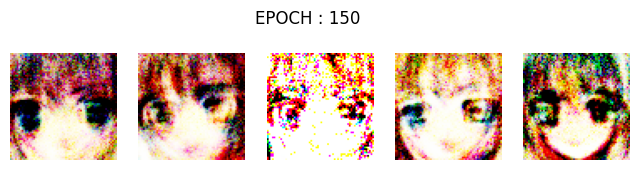

[Epoch: 151/200] [Batch: 348/348] [D loss: 0.117399] [G loss: 6.786291]
torch.Size([64, 3, 64, 64])


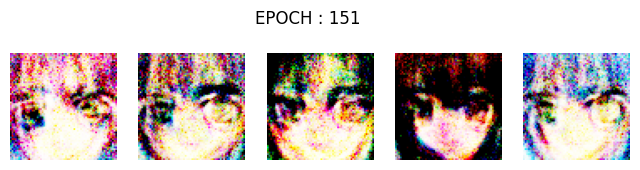

[Epoch: 152/200] [Batch: 348/348] [D loss: 0.081161] [G loss: 4.416493]
torch.Size([64, 3, 64, 64])


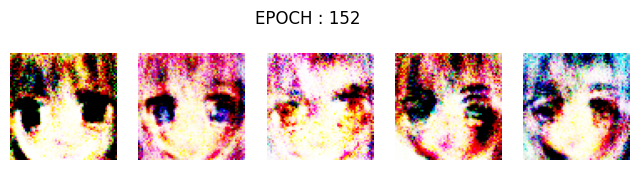

[Epoch: 153/200] [Batch: 348/348] [D loss: 0.185417] [G loss: 7.997557]
torch.Size([64, 3, 64, 64])


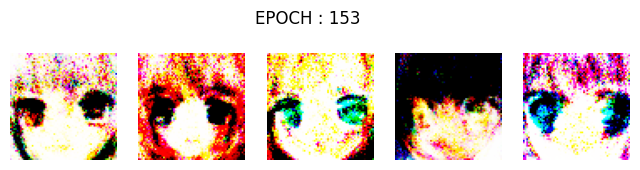

[Epoch: 154/200] [Batch: 348/348] [D loss: 0.105254] [G loss: 5.184940]
torch.Size([64, 3, 64, 64])


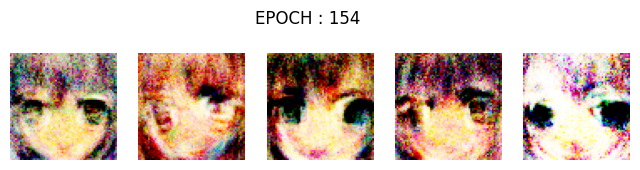

[Epoch: 155/200] [Batch: 348/348] [D loss: 0.163457] [G loss: 4.737624]
torch.Size([64, 3, 64, 64])


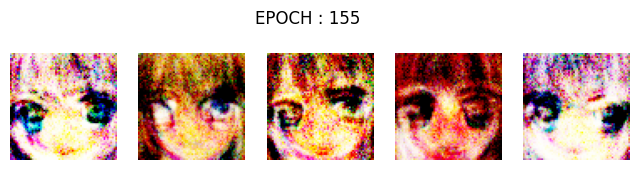

[Epoch: 156/200] [Batch: 348/348] [D loss: 0.183463] [G loss: 6.086322]
torch.Size([64, 3, 64, 64])


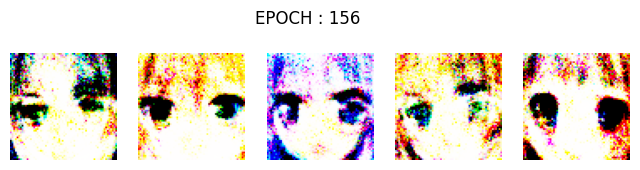

[Epoch: 157/200] [Batch: 348/348] [D loss: 0.089156] [G loss: 4.512277]
torch.Size([64, 3, 64, 64])


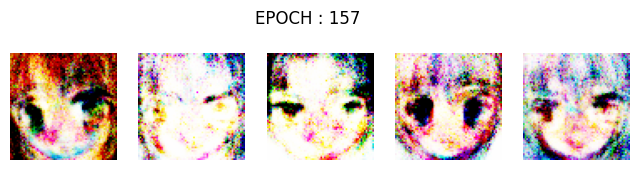

[Epoch: 158/200] [Batch: 348/348] [D loss: 0.042113] [G loss: 6.739206]
torch.Size([64, 3, 64, 64])


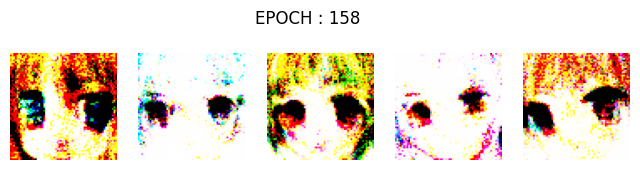

[Epoch: 159/200] [Batch: 348/348] [D loss: 0.010139] [G loss: 9.141602]
torch.Size([64, 3, 64, 64])


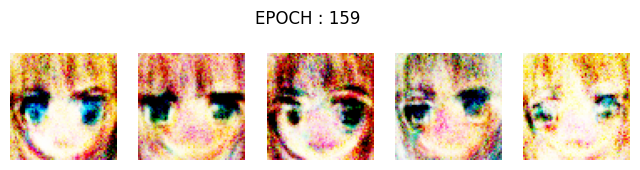

[Epoch: 160/200] [Batch: 348/348] [D loss: 0.227334] [G loss: 3.336274]
torch.Size([64, 3, 64, 64])


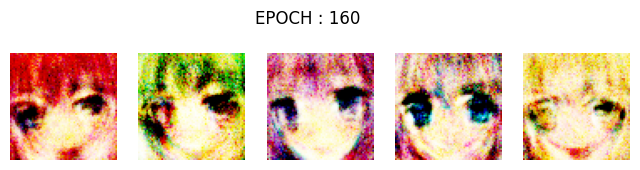

[Epoch: 161/200] [Batch: 348/348] [D loss: 0.038888] [G loss: 6.950108]
torch.Size([64, 3, 64, 64])


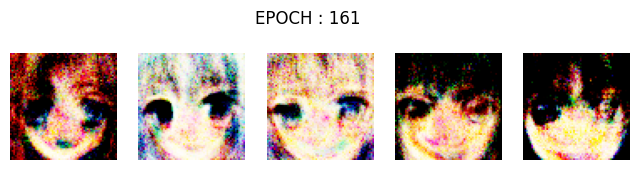

[Epoch: 162/200] [Batch: 348/348] [D loss: 0.167390] [G loss: 6.385069]
torch.Size([64, 3, 64, 64])


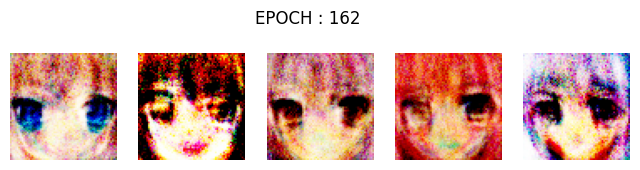

[Epoch: 163/200] [Batch: 348/348] [D loss: 0.313915] [G loss: 4.389269]
torch.Size([64, 3, 64, 64])


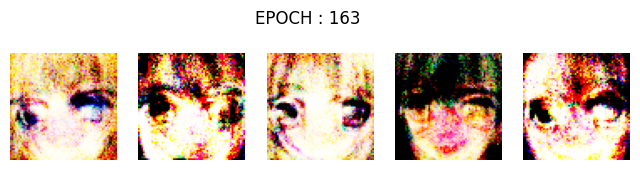

[Epoch: 164/200] [Batch: 348/348] [D loss: 0.088995] [G loss: 5.119296]
torch.Size([64, 3, 64, 64])


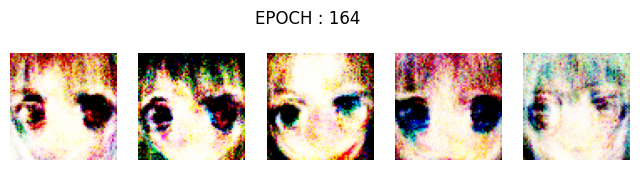

[Epoch: 165/200] [Batch: 348/348] [D loss: 0.255799] [G loss: 5.661839]
torch.Size([64, 3, 64, 64])


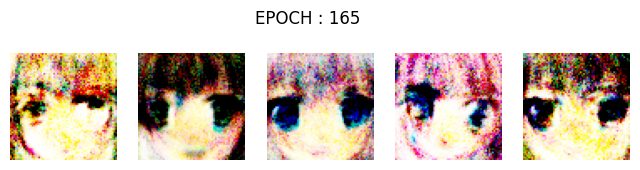

[Epoch: 166/200] [Batch: 348/348] [D loss: 0.280684] [G loss: 7.867586]
torch.Size([64, 3, 64, 64])


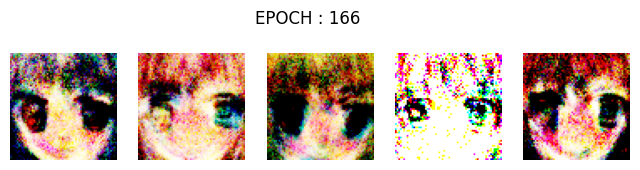

[Epoch: 167/200] [Batch: 348/348] [D loss: 0.155228] [G loss: 8.092333]
torch.Size([64, 3, 64, 64])


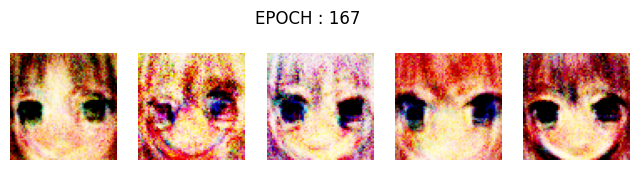

[Epoch: 168/200] [Batch: 348/348] [D loss: 0.163247] [G loss: 6.256736]
torch.Size([64, 3, 64, 64])


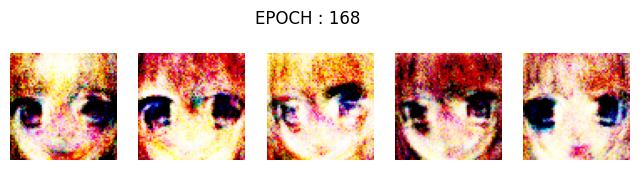

[Epoch: 169/200] [Batch: 348/348] [D loss: 0.116616] [G loss: 5.783352]
torch.Size([64, 3, 64, 64])


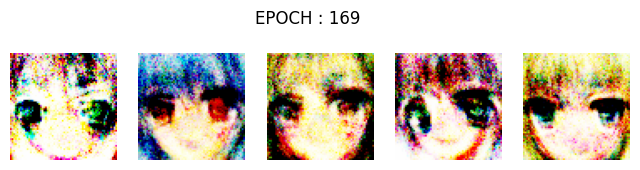

[Epoch: 170/200] [Batch: 348/348] [D loss: 0.090943] [G loss: 4.591505]
torch.Size([64, 3, 64, 64])


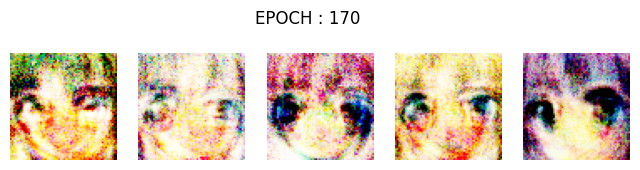

[Epoch: 171/200] [Batch: 348/348] [D loss: 0.124449] [G loss: 6.321183]
torch.Size([64, 3, 64, 64])


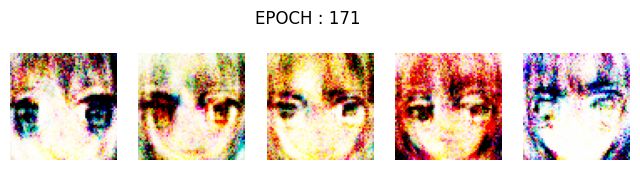

[Epoch: 172/200] [Batch: 348/348] [D loss: 0.041553] [G loss: 4.347037]
torch.Size([64, 3, 64, 64])


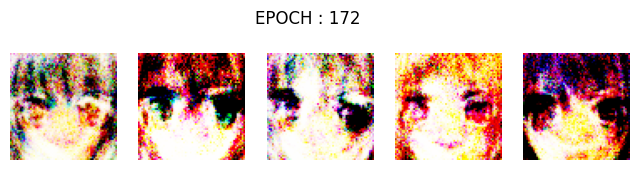

[Epoch: 173/200] [Batch: 348/348] [D loss: 0.090658] [G loss: 5.222025]
torch.Size([64, 3, 64, 64])


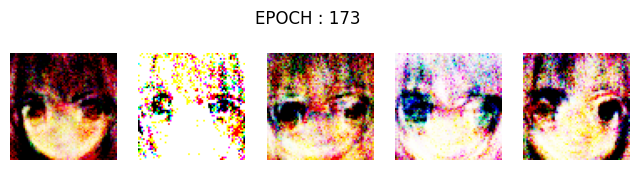

[Epoch: 174/200] [Batch: 348/348] [D loss: 0.201360] [G loss: 5.241785]
torch.Size([64, 3, 64, 64])


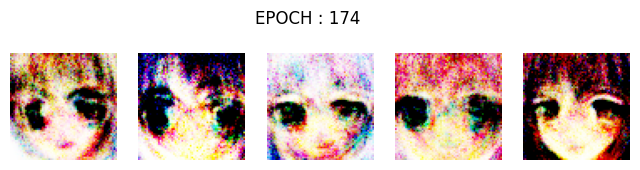

[Epoch: 175/200] [Batch: 348/348] [D loss: 0.270473] [G loss: 7.730381]
torch.Size([64, 3, 64, 64])


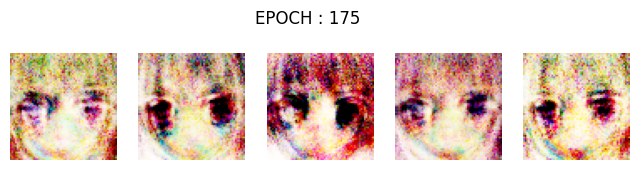

[Epoch: 176/200] [Batch: 348/348] [D loss: 0.107000] [G loss: 4.207146]
torch.Size([64, 3, 64, 64])


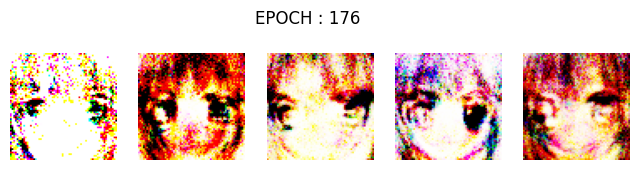

[Epoch: 177/200] [Batch: 348/348] [D loss: 0.066435] [G loss: 4.890491]
torch.Size([64, 3, 64, 64])


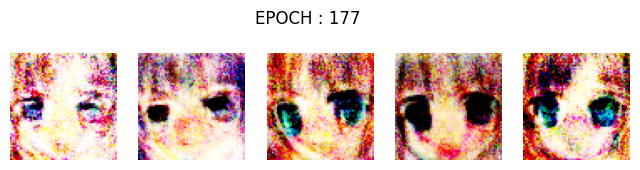

[Epoch: 178/200] [Batch: 348/348] [D loss: 0.052334] [G loss: 5.605479]
torch.Size([64, 3, 64, 64])


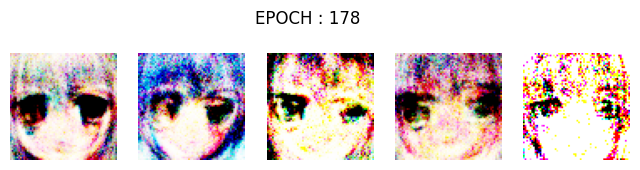

[Epoch: 179/200] [Batch: 348/348] [D loss: 0.059490] [G loss: 8.556122]
torch.Size([64, 3, 64, 64])


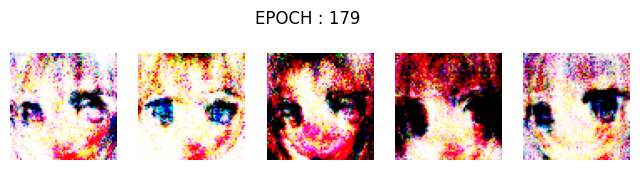

[Epoch: 180/200] [Batch: 348/348] [D loss: 0.153949] [G loss: 5.276951]
torch.Size([64, 3, 64, 64])


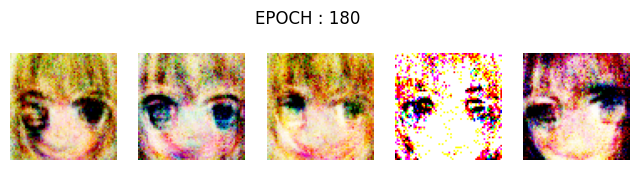

[Epoch: 181/200] [Batch: 348/348] [D loss: 0.121708] [G loss: 7.337952]
torch.Size([64, 3, 64, 64])


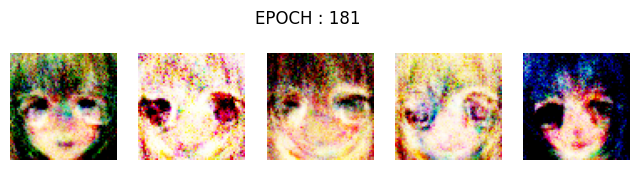

[Epoch: 182/200] [Batch: 348/348] [D loss: 0.045342] [G loss: 6.847301]
torch.Size([64, 3, 64, 64])


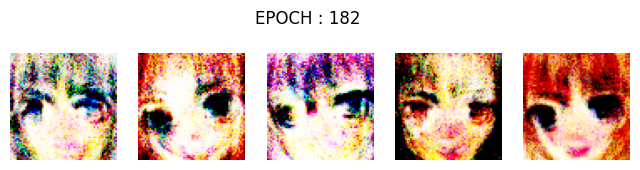

[Epoch: 183/200] [Batch: 348/348] [D loss: 0.346660] [G loss: 6.087362]
torch.Size([64, 3, 64, 64])


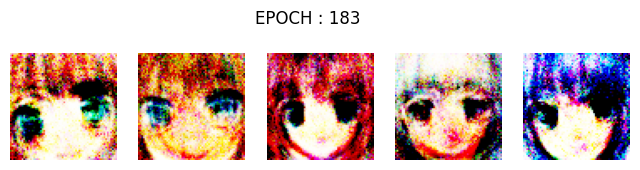

[Epoch: 184/200] [Batch: 348/348] [D loss: 0.125286] [G loss: 8.178552]
torch.Size([64, 3, 64, 64])


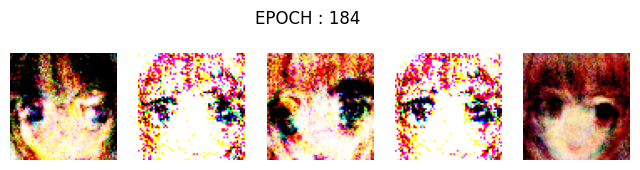

[Epoch: 185/200] [Batch: 348/348] [D loss: 0.152868] [G loss: 5.058168]
torch.Size([64, 3, 64, 64])


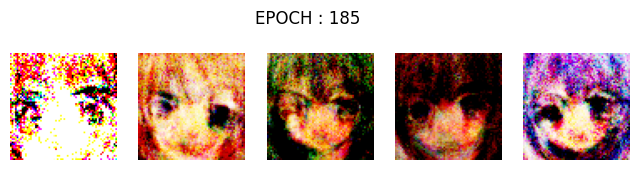

[Epoch: 186/200] [Batch: 348/348] [D loss: 0.138210] [G loss: 9.380444]
torch.Size([64, 3, 64, 64])


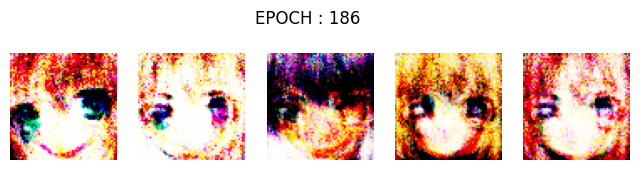

[Epoch: 187/200] [Batch: 348/348] [D loss: 0.168767] [G loss: 5.853843]
torch.Size([64, 3, 64, 64])


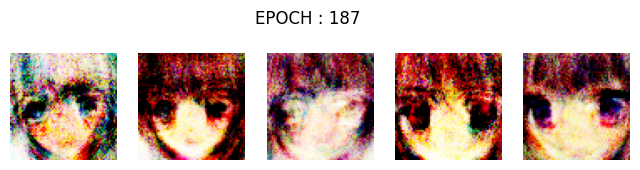

[Epoch: 188/200] [Batch: 348/348] [D loss: 0.085717] [G loss: 6.222324]
torch.Size([64, 3, 64, 64])


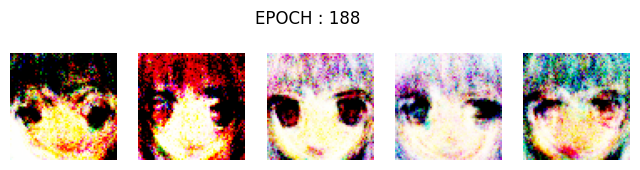

[Epoch: 189/200] [Batch: 348/348] [D loss: 0.037700] [G loss: 8.092304]
torch.Size([64, 3, 64, 64])


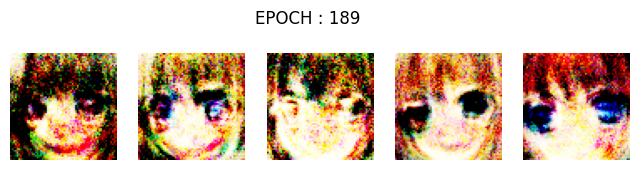

[Epoch: 190/200] [Batch: 348/348] [D loss: 0.095706] [G loss: 5.922933]
torch.Size([64, 3, 64, 64])


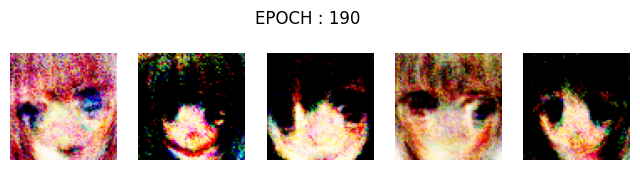

[Epoch: 191/200] [Batch: 348/348] [D loss: 0.286469] [G loss: 5.911025]
torch.Size([64, 3, 64, 64])


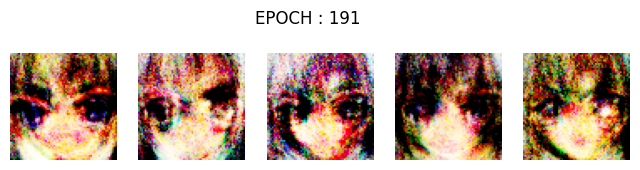

[Epoch: 192/200] [Batch: 348/348] [D loss: 0.081490] [G loss: 4.360033]
torch.Size([64, 3, 64, 64])


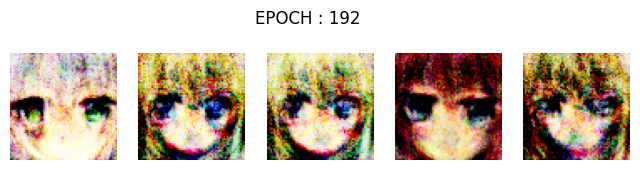

[Epoch: 193/200] [Batch: 348/348] [D loss: 0.083291] [G loss: 4.383502]
torch.Size([64, 3, 64, 64])


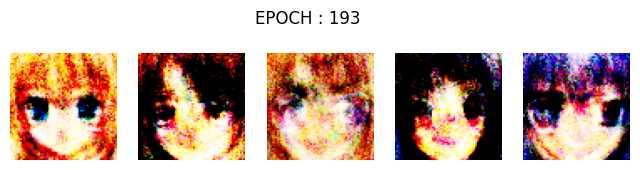

[Epoch: 194/200] [Batch: 348/348] [D loss: 0.111410] [G loss: 6.410835]
torch.Size([64, 3, 64, 64])


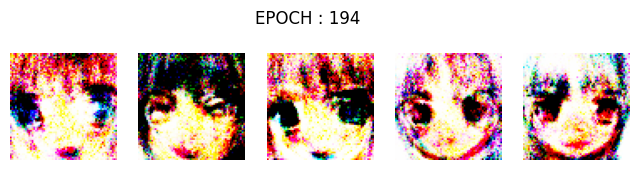

[Epoch: 195/200] [Batch: 348/348] [D loss: 0.089096] [G loss: 3.932882]
torch.Size([64, 3, 64, 64])


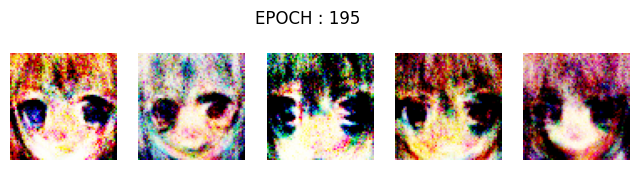

[Epoch: 196/200] [Batch: 348/348] [D loss: 0.166234] [G loss: 7.175145]
torch.Size([64, 3, 64, 64])


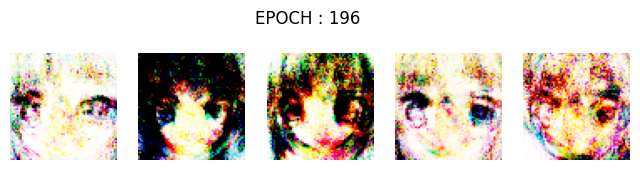

[Epoch: 197/200] [Batch: 348/348] [D loss: 0.066012] [G loss: 7.732080]
torch.Size([64, 3, 64, 64])


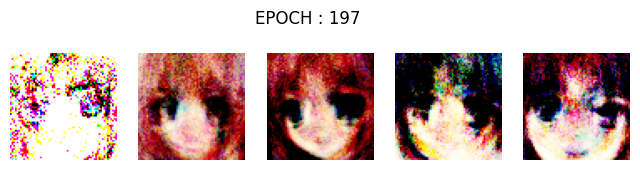

[Epoch: 198/200] [Batch: 348/348] [D loss: 0.107307] [G loss: 5.118988]
torch.Size([64, 3, 64, 64])


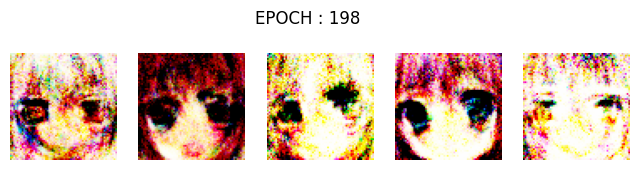

[Epoch: 199/200] [Batch: 348/348] [D loss: 0.087298] [G loss: 5.321045]
torch.Size([64, 3, 64, 64])


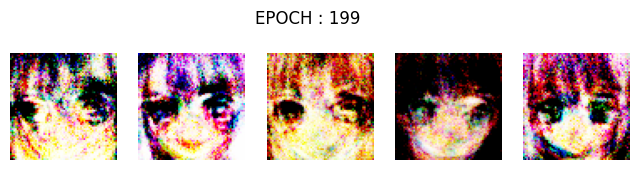

[Epoch: 200/200] [Batch: 348/348] [D loss: 0.137808] [G loss: 3.891466]
torch.Size([64, 3, 64, 64])


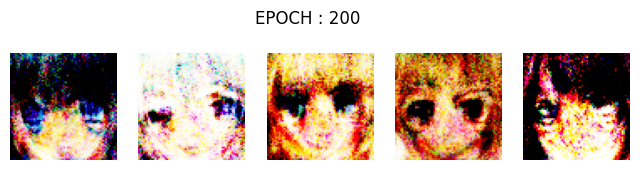

In [ ]:
train(200,training_loader,optimizer_G,optimizer_D,G,D,criterion)

In [ ]:
pathG="/content/gdrive/MyDrive/cse_676/Assignment_1/anime_G"
pathD="/content/gdrive/MyDrive/cse_676/Assignment_1/anime_D"
torch.save(G, pathG)
torch.save(D, pathD)

### referense



*   https://pytorch.org/tutorials/beginner/deep_learning_60min_blitz.html
*   https://pytorch.org/tutorials/beginner/saving_loading_models.html
*   https://pytorch.org/docs/stable/generated/torch.nn.Dropout.html
*   https://pytorch.org/vision/stable/transforms.html
*   https://www.kaggle.com/datasets/hojjatk/mnist-dataset
*   https://github.com/bchao1/Anime-Face-Dataset
*   https://www.kaggle.com/datasets/splcher/animefacedataset
*   https://www.kaggle.com/code/songseungwon/pytorch-gan-basic-tutorial-for-beginner








